<a href="https://colab.research.google.com/github/ykitaguchi77/Strabismus_AI_project/blob/main/GradCAM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import random
import glob
import os
import shutil
import numpy as np
import time
import pandas as pd

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
def get_path(orig_path, dst_path, split_num):
    classes = os.listdir(orig_path) #クラス名を取得
    #データの分割数を設定
    data_list = [0]*len(classes)
    k=0
    for i in classes:
        data_list[k] = glob.glob(orig_path+'/'+i+'/*')
        k+=1
    split_length = int(len(data_list)/split_num)
    return data_list, classes, split_length

def makefolder(orig_path, dst_path, classes):
    #フォルダを作成
    if os.path.exists(dst_path):
        shutil.rmtree(dst_path)
        print("Existing dataset deleted.")
    elif not os.path.exists(dst_path):  # ディレクトリがなかったら
        os.mkdir(dst_path)  # 作成したいフォルダ名を作成
        for i in range(split_num):
            os.mkdir(dst_path+'/'+str(i))
            os.mkdir(dst_path+'/'+str(i)+'/train')
            os.mkdir(dst_path+'/'+str(i)+'/val')
            for j in classes:
                os.mkdir(dst_path+'/'+str(i)+'/train/'+j)
                os.mkdir(dst_path+'/'+str(i)+'/val/'+j)

def split_data_list(data_list, split_num):
    split_data, dst_data, dst_train, dst_val, dst_test = [0]*split_num, [0]*split_num, [0]*split_num, [0]*split_num, [0]*split_num

    #データの分割
    split_data = list(np.array_split(data_list, split_num))

    #データセット全体と分割したデータの差分を取り、dst_dataに格納

    dst_data = [0] * split_num
    for i in range(split_num):
        dst_data[i] = [x for x in data_list if x not in split_data[i]]

    #トレーニングセット、バリデーションセット、テストセットのリスト作成
    for i in range(split_num):
        dst_train[i] = dst_data[i]
        dst_val[i] = split_data[i]  #テストセット
    
    return dst_train, dst_val

def copy_to_folders(split_num, class_name, dst_train, dst_val, dst_path):
    k=0
    for i in range(split_num):
        dst_path_train = dst_path +'/'+str(i)+'/train/'+class_name
        dst_path_val = dst_path +'/'+str(i)+'/val/'+class_name
        for p in dst_train[k]:  # 選択したファイルを目的フォルダにコピー
            shutil.copy(p, dst_path_train)
            #print(p)
            print(dst_path_train)

        for p in dst_val[k]:  # 選択したファイルを目的フォルダにコピー
            shutil.copy(p, dst_path_val)
            #print(p)    
            print(dst_path_val)

        k+=1

In [3]:
#パスの設定
orig_path = "/content/drive/MyDrive/Deep_learning/Strabismus/Dataset_250px_20211116"
dst_path = "/content/drive/MyDrive/Deep_learning/Strabismus/Dataset_250px_shuffle3_crossvalidation_eso"
csv_path = dst_path + "/img_list.csv"


In [4]:
#Dataの分割の設定
split_num = 5  #データをいくつに分割するかを記載
data_list, classes, split_length = get_path(orig_path, dst_path, split_num)
print(classes)

['eso', 'exo', 'cont']


In [5]:
#作成するデータのクラスを設定し直す
#疾患群を後ろにする
dst_classes = ['cont', 'exo']

class_num = []
for i in dst_classes:
    class_num.append(classes.index(i))
print(dst_classes)
print(class_num)

['cont', 'exo']
[2, 1]


In [ ]:
#5-foldデータセットの作成
#作成済みの場合には省略
makefolder(orig_path, dst_path, dst_classes)
print(classes)
k=0
for i in class_num:
    random.shuffle(data_list[i]) #shuffleをするときはこれを入れる
    dst_train, dst_val = split_data_list(data_list[i][0:128], split_num)  #[0:256]でデータの数を制限する。[0:]にすると全部入る
    print(classes[i])
    copy_to_folders(split_num, classes[i], dst_train, dst_val, dst_path)
    k+=1

In [6]:
classes = os.listdir(dst_path+"/0/val/")
split_num = 5
img_num = len(glob.glob(dst_path+"/*/val/*/*"))
#print(glob.glob(dst_path+"/*/val/*/*"))
#print(img_num)

#Make CSV file
cols = ["num", "division", "class", "prediction"]
df_cross = pd.DataFrame(index=list(range(img_num)), columns=cols)

t=0
for i in range(split_num):
    for j in classes:
        #print(str(i) + ", "+str(j))
        img_list = os.listdir(dst_path+"/"+str(i)+"/val/"+str(j))
        #print(img_list)
        for k in img_list:
            df_cross.iloc[t,0]=str(k)
            df_cross.iloc[t,1]=str(i)
            df_cross.iloc[t,2]=str(j)
            t+=1
df_cross

#CSV fileを保存
csv = df_cross.to_csv(csv_path, encoding='utf_8_sig')

from __future__ import print_function, division
!pip install torch_optimizer

#!pip install adabelief-pytorch==0.1.0
!pip install ranger-adabelief==0.1.0
from ranger_adabelief import RangerAdaBelief

import torch
import torch.nn as nn
import torch_optimizer as optim
import torch.utils.data as data
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
import os
import copy
import math
import shutil

import glob
import os.path as osp
import random
import json
from PIL import Image
from tqdm import tqdm
%matplotlib inline

import pandas as pd
import csv

#サポートパッチのインポート
from google.colab.patches import cv2_imshow
import cv2

plt.ion()   # interactive mode
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

!pip install efficientnet_pytorch
from efficientnet_pytorch import EfficientNet 

import numpy as np
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

#Module群

#Define ResNet5-VGGFace
class Resnet50_ft_dag(nn.Module):

    def __init__(self):
        super(Resnet50_ft_dag, self).__init__()
        self.meta = {'mean': [131.0912, 103.8827, 91.4953],
                     'std': [1, 1, 1],
                     'imageSize': [224, 224, 3]}
        self.conv1_7x7_s2 = nn.Conv2d(3, 64, kernel_size=[7, 7], stride=(2, 2), padding=(3, 3), bias=False)
        self.conv1_7x7_s2_bn = nn.BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv1_relu_7x7_s2 = nn.ReLU()
        self.pool1_3x3_s2 = nn.MaxPool2d(kernel_size=[3, 3], stride=[2, 2], padding=(0, 0), dilation=1, ceil_mode=True)
        self.conv2_1_1x1_reduce = nn.Conv2d(64, 64, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv2_1_1x1_reduce_bn = nn.BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2_1_1x1_reduce_relu = nn.ReLU()
        self.conv2_1_3x3 = nn.Conv2d(64, 64, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv2_1_3x3_bn = nn.BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2_1_3x3_relu = nn.ReLU()
        self.conv2_1_1x1_increase = nn.Conv2d(64, 256, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv2_1_1x1_increase_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2_1_1x1_proj = nn.Conv2d(64, 256, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv2_1_1x1_proj_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2_1_relu = nn.ReLU()
        self.conv2_2_1x1_reduce = nn.Conv2d(256, 64, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv2_2_1x1_reduce_bn = nn.BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2_2_1x1_reduce_relu = nn.ReLU()
        self.conv2_2_3x3 = nn.Conv2d(64, 64, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv2_2_3x3_bn = nn.BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2_2_3x3_relu = nn.ReLU()
        self.conv2_2_1x1_increase = nn.Conv2d(64, 256, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv2_2_1x1_increase_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2_2_relu = nn.ReLU()
        self.conv2_3_1x1_reduce = nn.Conv2d(256, 64, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv2_3_1x1_reduce_bn = nn.BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2_3_1x1_reduce_relu = nn.ReLU()
        self.conv2_3_3x3 = nn.Conv2d(64, 64, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv2_3_3x3_bn = nn.BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2_3_3x3_relu = nn.ReLU()
        self.conv2_3_1x1_increase = nn.Conv2d(64, 256, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv2_3_1x1_increase_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2_3_relu = nn.ReLU()
        self.conv3_1_1x1_reduce = nn.Conv2d(256, 128, kernel_size=[1, 1], stride=(2, 2), bias=False)
        self.conv3_1_1x1_reduce_bn = nn.BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_1_1x1_reduce_relu = nn.ReLU()
        self.conv3_1_3x3 = nn.Conv2d(128, 128, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv3_1_3x3_bn = nn.BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_1_3x3_relu = nn.ReLU()
        self.conv3_1_1x1_increase = nn.Conv2d(128, 512, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv3_1_1x1_increase_bn = nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_1_1x1_proj = nn.Conv2d(256, 512, kernel_size=[1, 1], stride=(2, 2), bias=False)
        self.conv3_1_1x1_proj_bn = nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_1_relu = nn.ReLU()
        self.conv3_2_1x1_reduce = nn.Conv2d(512, 128, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv3_2_1x1_reduce_bn = nn.BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_2_1x1_reduce_relu = nn.ReLU()
        self.conv3_2_3x3 = nn.Conv2d(128, 128, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv3_2_3x3_bn = nn.BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_2_3x3_relu = nn.ReLU()
        self.conv3_2_1x1_increase = nn.Conv2d(128, 512, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv3_2_1x1_increase_bn = nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_2_relu = nn.ReLU()
        self.conv3_3_1x1_reduce = nn.Conv2d(512, 128, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv3_3_1x1_reduce_bn = nn.BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_3_1x1_reduce_relu = nn.ReLU()
        self.conv3_3_3x3 = nn.Conv2d(128, 128, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv3_3_3x3_bn = nn.BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_3_3x3_relu = nn.ReLU()
        self.conv3_3_1x1_increase = nn.Conv2d(128, 512, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv3_3_1x1_increase_bn = nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_3_relu = nn.ReLU()
        self.conv3_4_1x1_reduce = nn.Conv2d(512, 128, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv3_4_1x1_reduce_bn = nn.BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_4_1x1_reduce_relu = nn.ReLU()
        self.conv3_4_3x3 = nn.Conv2d(128, 128, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv3_4_3x3_bn = nn.BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_4_3x3_relu = nn.ReLU()
        self.conv3_4_1x1_increase = nn.Conv2d(128, 512, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv3_4_1x1_increase_bn = nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv3_4_relu = nn.ReLU()
        self.conv4_1_1x1_reduce = nn.Conv2d(512, 256, kernel_size=[1, 1], stride=(2, 2), bias=False)
        self.conv4_1_1x1_reduce_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_1_1x1_reduce_relu = nn.ReLU()
        self.conv4_1_3x3 = nn.Conv2d(256, 256, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv4_1_3x3_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_1_3x3_relu = nn.ReLU()
        self.conv4_1_1x1_increase = nn.Conv2d(256, 1024, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv4_1_1x1_increase_bn = nn.BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_1_1x1_proj = nn.Conv2d(512, 1024, kernel_size=[1, 1], stride=(2, 2), bias=False)
        self.conv4_1_1x1_proj_bn = nn.BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_1_relu = nn.ReLU()
        self.conv4_2_1x1_reduce = nn.Conv2d(1024, 256, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv4_2_1x1_reduce_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_2_1x1_reduce_relu = nn.ReLU()
        self.conv4_2_3x3 = nn.Conv2d(256, 256, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv4_2_3x3_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_2_3x3_relu = nn.ReLU()
        self.conv4_2_1x1_increase = nn.Conv2d(256, 1024, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv4_2_1x1_increase_bn = nn.BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_2_relu = nn.ReLU()
        self.conv4_3_1x1_reduce = nn.Conv2d(1024, 256, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv4_3_1x1_reduce_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_3_1x1_reduce_relu = nn.ReLU()
        self.conv4_3_3x3 = nn.Conv2d(256, 256, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv4_3_3x3_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_3_3x3_relu = nn.ReLU()
        self.conv4_3_1x1_increase = nn.Conv2d(256, 1024, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv4_3_1x1_increase_bn = nn.BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_3_relu = nn.ReLU()
        self.conv4_4_1x1_reduce = nn.Conv2d(1024, 256, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv4_4_1x1_reduce_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_4_1x1_reduce_relu = nn.ReLU()
        self.conv4_4_3x3 = nn.Conv2d(256, 256, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv4_4_3x3_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_4_3x3_relu = nn.ReLU()
        self.conv4_4_1x1_increase = nn.Conv2d(256, 1024, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv4_4_1x1_increase_bn = nn.BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_4_relu = nn.ReLU()
        self.conv4_5_1x1_reduce = nn.Conv2d(1024, 256, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv4_5_1x1_reduce_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_5_1x1_reduce_relu = nn.ReLU()
        self.conv4_5_3x3 = nn.Conv2d(256, 256, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv4_5_3x3_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_5_3x3_relu = nn.ReLU()
        self.conv4_5_1x1_increase = nn.Conv2d(256, 1024, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv4_5_1x1_increase_bn = nn.BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_5_relu = nn.ReLU()
        self.conv4_6_1x1_reduce = nn.Conv2d(1024, 256, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv4_6_1x1_reduce_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_6_1x1_reduce_relu = nn.ReLU()
        self.conv4_6_3x3 = nn.Conv2d(256, 256, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv4_6_3x3_bn = nn.BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_6_3x3_relu = nn.ReLU()
        self.conv4_6_1x1_increase = nn.Conv2d(256, 1024, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv4_6_1x1_increase_bn = nn.BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv4_6_relu = nn.ReLU()
        self.conv5_1_1x1_reduce = nn.Conv2d(1024, 512, kernel_size=[1, 1], stride=(2, 2), bias=False)
        self.conv5_1_1x1_reduce_bn = nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv5_1_1x1_reduce_relu = nn.ReLU()
        self.conv5_1_3x3 = nn.Conv2d(512, 512, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv5_1_3x3_bn = nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv5_1_3x3_relu = nn.ReLU()
        self.conv5_1_1x1_increase = nn.Conv2d(512, 2048, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv5_1_1x1_increase_bn = nn.BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv5_1_1x1_proj = nn.Conv2d(1024, 2048, kernel_size=[1, 1], stride=(2, 2), bias=False)
        self.conv5_1_1x1_proj_bn = nn.BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv5_1_relu = nn.ReLU()
        self.conv5_2_1x1_reduce = nn.Conv2d(2048, 512, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv5_2_1x1_reduce_bn = nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv5_2_1x1_reduce_relu = nn.ReLU()
        self.conv5_2_3x3 = nn.Conv2d(512, 512, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv5_2_3x3_bn = nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv5_2_3x3_relu = nn.ReLU()
        self.conv5_2_1x1_increase = nn.Conv2d(512, 2048, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv5_2_1x1_increase_bn = nn.BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv5_2_relu = nn.ReLU()
        self.conv5_3_1x1_reduce = nn.Conv2d(2048, 512, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv5_3_1x1_reduce_bn = nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv5_3_1x1_reduce_relu = nn.ReLU()
        self.conv5_3_3x3 = nn.Conv2d(512, 512, kernel_size=[3, 3], stride=(1, 1), padding=(1, 1), bias=False)
        self.conv5_3_3x3_bn = nn.BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv5_3_3x3_relu = nn.ReLU()
        self.conv5_3_1x1_increase = nn.Conv2d(512, 2048, kernel_size=[1, 1], stride=(1, 1), bias=False)
        self.conv5_3_1x1_increase_bn = nn.BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv5_3_relu = nn.ReLU()
        self.pool5_7x7_s1 = nn.AvgPool2d(kernel_size=[7, 7], stride=[1, 1], padding=0)
        self.classifier = nn.Conv2d(2048, 8631, kernel_size=[1, 1], stride=(1, 1))

    def forward(self, data):
        conv1_7x7_s2 = self.conv1_7x7_s2(data)
        conv1_7x7_s2_bn = self.conv1_7x7_s2_bn(conv1_7x7_s2)
        conv1_7x7_s2_bnxx = self.conv1_relu_7x7_s2(conv1_7x7_s2_bn)
        pool1_3x3_s2 = self.pool1_3x3_s2(conv1_7x7_s2_bnxx)
        conv2_1_1x1_reduce = self.conv2_1_1x1_reduce(pool1_3x3_s2)
        conv2_1_1x1_reduce_bn = self.conv2_1_1x1_reduce_bn(conv2_1_1x1_reduce)
        conv2_1_1x1_reduce_bnxx = self.conv2_1_1x1_reduce_relu(conv2_1_1x1_reduce_bn)
        conv2_1_3x3 = self.conv2_1_3x3(conv2_1_1x1_reduce_bnxx)
        conv2_1_3x3_bn = self.conv2_1_3x3_bn(conv2_1_3x3)
        conv2_1_3x3_bnxx = self.conv2_1_3x3_relu(conv2_1_3x3_bn)
        conv2_1_1x1_increase = self.conv2_1_1x1_increase(conv2_1_3x3_bnxx)
        conv2_1_1x1_increase_bn = self.conv2_1_1x1_increase_bn(conv2_1_1x1_increase)
        conv2_1_1x1_proj = self.conv2_1_1x1_proj(pool1_3x3_s2)
        conv2_1_1x1_proj_bn = self.conv2_1_1x1_proj_bn(conv2_1_1x1_proj)
        conv2_1 = torch.add(conv2_1_1x1_proj_bn, 1, conv2_1_1x1_increase_bn)
        conv2_1x = self.conv2_1_relu(conv2_1)
        conv2_2_1x1_reduce = self.conv2_2_1x1_reduce(conv2_1x)
        conv2_2_1x1_reduce_bn = self.conv2_2_1x1_reduce_bn(conv2_2_1x1_reduce)
        conv2_2_1x1_reduce_bnxx = self.conv2_2_1x1_reduce_relu(conv2_2_1x1_reduce_bn)
        conv2_2_3x3 = self.conv2_2_3x3(conv2_2_1x1_reduce_bnxx)
        conv2_2_3x3_bn = self.conv2_2_3x3_bn(conv2_2_3x3)
        conv2_2_3x3_bnxx = self.conv2_2_3x3_relu(conv2_2_3x3_bn)
        conv2_2_1x1_increase = self.conv2_2_1x1_increase(conv2_2_3x3_bnxx)
        conv2_2_1x1_increase_bn = self.conv2_2_1x1_increase_bn(conv2_2_1x1_increase)
        conv2_2 = torch.add(conv2_1x, 1, conv2_2_1x1_increase_bn)
        conv2_2x = self.conv2_2_relu(conv2_2)
        conv2_3_1x1_reduce = self.conv2_3_1x1_reduce(conv2_2x)
        conv2_3_1x1_reduce_bn = self.conv2_3_1x1_reduce_bn(conv2_3_1x1_reduce)
        conv2_3_1x1_reduce_bnxx = self.conv2_3_1x1_reduce_relu(conv2_3_1x1_reduce_bn)
        conv2_3_3x3 = self.conv2_3_3x3(conv2_3_1x1_reduce_bnxx)
        conv2_3_3x3_bn = self.conv2_3_3x3_bn(conv2_3_3x3)
        conv2_3_3x3_bnxx = self.conv2_3_3x3_relu(conv2_3_3x3_bn)
        conv2_3_1x1_increase = self.conv2_3_1x1_increase(conv2_3_3x3_bnxx)
        conv2_3_1x1_increase_bn = self.conv2_3_1x1_increase_bn(conv2_3_1x1_increase)
        conv2_3 = torch.add(conv2_2x, 1, conv2_3_1x1_increase_bn)
        conv2_3x = self.conv2_3_relu(conv2_3)
        conv3_1_1x1_reduce = self.conv3_1_1x1_reduce(conv2_3x)
        conv3_1_1x1_reduce_bn = self.conv3_1_1x1_reduce_bn(conv3_1_1x1_reduce)
        conv3_1_1x1_reduce_bnxx = self.conv3_1_1x1_reduce_relu(conv3_1_1x1_reduce_bn)
        conv3_1_3x3 = self.conv3_1_3x3(conv3_1_1x1_reduce_bnxx)
        conv3_1_3x3_bn = self.conv3_1_3x3_bn(conv3_1_3x3)
        conv3_1_3x3_bnxx = self.conv3_1_3x3_relu(conv3_1_3x3_bn)
        conv3_1_1x1_increase = self.conv3_1_1x1_increase(conv3_1_3x3_bnxx)
        conv3_1_1x1_increase_bn = self.conv3_1_1x1_increase_bn(conv3_1_1x1_increase)
        conv3_1_1x1_proj = self.conv3_1_1x1_proj(conv2_3x)
        conv3_1_1x1_proj_bn = self.conv3_1_1x1_proj_bn(conv3_1_1x1_proj)
        conv3_1 = torch.add(conv3_1_1x1_proj_bn, 1, conv3_1_1x1_increase_bn)
        conv3_1x = self.conv3_1_relu(conv3_1)
        conv3_2_1x1_reduce = self.conv3_2_1x1_reduce(conv3_1x)
        conv3_2_1x1_reduce_bn = self.conv3_2_1x1_reduce_bn(conv3_2_1x1_reduce)
        conv3_2_1x1_reduce_bnxx = self.conv3_2_1x1_reduce_relu(conv3_2_1x1_reduce_bn)
        conv3_2_3x3 = self.conv3_2_3x3(conv3_2_1x1_reduce_bnxx)
        conv3_2_3x3_bn = self.conv3_2_3x3_bn(conv3_2_3x3)
        conv3_2_3x3_bnxx = self.conv3_2_3x3_relu(conv3_2_3x3_bn)
        conv3_2_1x1_increase = self.conv3_2_1x1_increase(conv3_2_3x3_bnxx)
        conv3_2_1x1_increase_bn = self.conv3_2_1x1_increase_bn(conv3_2_1x1_increase)
        conv3_2 = torch.add(conv3_1x, 1, conv3_2_1x1_increase_bn)
        conv3_2x = self.conv3_2_relu(conv3_2)
        conv3_3_1x1_reduce = self.conv3_3_1x1_reduce(conv3_2x)
        conv3_3_1x1_reduce_bn = self.conv3_3_1x1_reduce_bn(conv3_3_1x1_reduce)
        conv3_3_1x1_reduce_bnxx = self.conv3_3_1x1_reduce_relu(conv3_3_1x1_reduce_bn)
        conv3_3_3x3 = self.conv3_3_3x3(conv3_3_1x1_reduce_bnxx)
        conv3_3_3x3_bn = self.conv3_3_3x3_bn(conv3_3_3x3)
        conv3_3_3x3_bnxx = self.conv3_3_3x3_relu(conv3_3_3x3_bn)
        conv3_3_1x1_increase = self.conv3_3_1x1_increase(conv3_3_3x3_bnxx)
        conv3_3_1x1_increase_bn = self.conv3_3_1x1_increase_bn(conv3_3_1x1_increase)
        conv3_3 = torch.add(conv3_2x, 1, conv3_3_1x1_increase_bn)
        conv3_3x = self.conv3_3_relu(conv3_3)
        conv3_4_1x1_reduce = self.conv3_4_1x1_reduce(conv3_3x)
        conv3_4_1x1_reduce_bn = self.conv3_4_1x1_reduce_bn(conv3_4_1x1_reduce)
        conv3_4_1x1_reduce_bnxx = self.conv3_4_1x1_reduce_relu(conv3_4_1x1_reduce_bn)
        conv3_4_3x3 = self.conv3_4_3x3(conv3_4_1x1_reduce_bnxx)
        conv3_4_3x3_bn = self.conv3_4_3x3_bn(conv3_4_3x3)
        conv3_4_3x3_bnxx = self.conv3_4_3x3_relu(conv3_4_3x3_bn)
        conv3_4_1x1_increase = self.conv3_4_1x1_increase(conv3_4_3x3_bnxx)
        conv3_4_1x1_increase_bn = self.conv3_4_1x1_increase_bn(conv3_4_1x1_increase)
        conv3_4 = torch.add(conv3_3x, 1, conv3_4_1x1_increase_bn)
        conv3_4x = self.conv3_4_relu(conv3_4)
        conv4_1_1x1_reduce = self.conv4_1_1x1_reduce(conv3_4x)
        conv4_1_1x1_reduce_bn = self.conv4_1_1x1_reduce_bn(conv4_1_1x1_reduce)
        conv4_1_1x1_reduce_bnxx = self.conv4_1_1x1_reduce_relu(conv4_1_1x1_reduce_bn)
        conv4_1_3x3 = self.conv4_1_3x3(conv4_1_1x1_reduce_bnxx)
        conv4_1_3x3_bn = self.conv4_1_3x3_bn(conv4_1_3x3)
        conv4_1_3x3_bnxx = self.conv4_1_3x3_relu(conv4_1_3x3_bn)
        conv4_1_1x1_increase = self.conv4_1_1x1_increase(conv4_1_3x3_bnxx)
        conv4_1_1x1_increase_bn = self.conv4_1_1x1_increase_bn(conv4_1_1x1_increase)
        conv4_1_1x1_proj = self.conv4_1_1x1_proj(conv3_4x)
        conv4_1_1x1_proj_bn = self.conv4_1_1x1_proj_bn(conv4_1_1x1_proj)
        conv4_1 = torch.add(conv4_1_1x1_proj_bn, 1, conv4_1_1x1_increase_bn)
        conv4_1x = self.conv4_1_relu(conv4_1)
        conv4_2_1x1_reduce = self.conv4_2_1x1_reduce(conv4_1x)
        conv4_2_1x1_reduce_bn = self.conv4_2_1x1_reduce_bn(conv4_2_1x1_reduce)
        conv4_2_1x1_reduce_bnxx = self.conv4_2_1x1_reduce_relu(conv4_2_1x1_reduce_bn)
        conv4_2_3x3 = self.conv4_2_3x3(conv4_2_1x1_reduce_bnxx)
        conv4_2_3x3_bn = self.conv4_2_3x3_bn(conv4_2_3x3)
        conv4_2_3x3_bnxx = self.conv4_2_3x3_relu(conv4_2_3x3_bn)
        conv4_2_1x1_increase = self.conv4_2_1x1_increase(conv4_2_3x3_bnxx)
        conv4_2_1x1_increase_bn = self.conv4_2_1x1_increase_bn(conv4_2_1x1_increase)
        conv4_2 = torch.add(conv4_1x, 1, conv4_2_1x1_increase_bn)
        conv4_2x = self.conv4_2_relu(conv4_2)
        conv4_3_1x1_reduce = self.conv4_3_1x1_reduce(conv4_2x)
        conv4_3_1x1_reduce_bn = self.conv4_3_1x1_reduce_bn(conv4_3_1x1_reduce)
        conv4_3_1x1_reduce_bnxx = self.conv4_3_1x1_reduce_relu(conv4_3_1x1_reduce_bn)
        conv4_3_3x3 = self.conv4_3_3x3(conv4_3_1x1_reduce_bnxx)
        conv4_3_3x3_bn = self.conv4_3_3x3_bn(conv4_3_3x3)
        conv4_3_3x3_bnxx = self.conv4_3_3x3_relu(conv4_3_3x3_bn)
        conv4_3_1x1_increase = self.conv4_3_1x1_increase(conv4_3_3x3_bnxx)
        conv4_3_1x1_increase_bn = self.conv4_3_1x1_increase_bn(conv4_3_1x1_increase)
        conv4_3 = torch.add(conv4_2x, 1, conv4_3_1x1_increase_bn)
        conv4_3x = self.conv4_3_relu(conv4_3)
        conv4_4_1x1_reduce = self.conv4_4_1x1_reduce(conv4_3x)
        conv4_4_1x1_reduce_bn = self.conv4_4_1x1_reduce_bn(conv4_4_1x1_reduce)
        conv4_4_1x1_reduce_bnxx = self.conv4_4_1x1_reduce_relu(conv4_4_1x1_reduce_bn)
        conv4_4_3x3 = self.conv4_4_3x3(conv4_4_1x1_reduce_bnxx)
        conv4_4_3x3_bn = self.conv4_4_3x3_bn(conv4_4_3x3)
        conv4_4_3x3_bnxx = self.conv4_4_3x3_relu(conv4_4_3x3_bn)
        conv4_4_1x1_increase = self.conv4_4_1x1_increase(conv4_4_3x3_bnxx)
        conv4_4_1x1_increase_bn = self.conv4_4_1x1_increase_bn(conv4_4_1x1_increase)
        conv4_4 = torch.add(conv4_3x, 1, conv4_4_1x1_increase_bn)
        conv4_4x = self.conv4_4_relu(conv4_4)
        conv4_5_1x1_reduce = self.conv4_5_1x1_reduce(conv4_4x)
        conv4_5_1x1_reduce_bn = self.conv4_5_1x1_reduce_bn(conv4_5_1x1_reduce)
        conv4_5_1x1_reduce_bnxx = self.conv4_5_1x1_reduce_relu(conv4_5_1x1_reduce_bn)
        conv4_5_3x3 = self.conv4_5_3x3(conv4_5_1x1_reduce_bnxx)
        conv4_5_3x3_bn = self.conv4_5_3x3_bn(conv4_5_3x3)
        conv4_5_3x3_bnxx = self.conv4_5_3x3_relu(conv4_5_3x3_bn)
        conv4_5_1x1_increase = self.conv4_5_1x1_increase(conv4_5_3x3_bnxx)
        conv4_5_1x1_increase_bn = self.conv4_5_1x1_increase_bn(conv4_5_1x1_increase)
        conv4_5 = torch.add(conv4_4x, 1, conv4_5_1x1_increase_bn)
        conv4_5x = self.conv4_5_relu(conv4_5)
        conv4_6_1x1_reduce = self.conv4_6_1x1_reduce(conv4_5x)
        conv4_6_1x1_reduce_bn = self.conv4_6_1x1_reduce_bn(conv4_6_1x1_reduce)
        conv4_6_1x1_reduce_bnxx = self.conv4_6_1x1_reduce_relu(conv4_6_1x1_reduce_bn)
        conv4_6_3x3 = self.conv4_6_3x3(conv4_6_1x1_reduce_bnxx)
        conv4_6_3x3_bn = self.conv4_6_3x3_bn(conv4_6_3x3)
        conv4_6_3x3_bnxx = self.conv4_6_3x3_relu(conv4_6_3x3_bn)
        conv4_6_1x1_increase = self.conv4_6_1x1_increase(conv4_6_3x3_bnxx)
        conv4_6_1x1_increase_bn = self.conv4_6_1x1_increase_bn(conv4_6_1x1_increase)
        conv4_6 = torch.add(conv4_5x, 1, conv4_6_1x1_increase_bn)
        conv4_6x = self.conv4_6_relu(conv4_6)
        conv5_1_1x1_reduce = self.conv5_1_1x1_reduce(conv4_6x)
        conv5_1_1x1_reduce_bn = self.conv5_1_1x1_reduce_bn(conv5_1_1x1_reduce)
        conv5_1_1x1_reduce_bnxx = self.conv5_1_1x1_reduce_relu(conv5_1_1x1_reduce_bn)
        conv5_1_3x3 = self.conv5_1_3x3(conv5_1_1x1_reduce_bnxx)
        conv5_1_3x3_bn = self.conv5_1_3x3_bn(conv5_1_3x3)
        conv5_1_3x3_bnxx = self.conv5_1_3x3_relu(conv5_1_3x3_bn)
        conv5_1_1x1_increase = self.conv5_1_1x1_increase(conv5_1_3x3_bnxx)
        conv5_1_1x1_increase_bn = self.conv5_1_1x1_increase_bn(conv5_1_1x1_increase)
        conv5_1_1x1_proj = self.conv5_1_1x1_proj(conv4_6x)
        conv5_1_1x1_proj_bn = self.conv5_1_1x1_proj_bn(conv5_1_1x1_proj)
        conv5_1 = torch.add(conv5_1_1x1_proj_bn, 1, conv5_1_1x1_increase_bn)
        conv5_1x = self.conv5_1_relu(conv5_1)
        conv5_2_1x1_reduce = self.conv5_2_1x1_reduce(conv5_1x)
        conv5_2_1x1_reduce_bn = self.conv5_2_1x1_reduce_bn(conv5_2_1x1_reduce)
        conv5_2_1x1_reduce_bnxx = self.conv5_2_1x1_reduce_relu(conv5_2_1x1_reduce_bn)
        conv5_2_3x3 = self.conv5_2_3x3(conv5_2_1x1_reduce_bnxx)
        conv5_2_3x3_bn = self.conv5_2_3x3_bn(conv5_2_3x3)
        conv5_2_3x3_bnxx = self.conv5_2_3x3_relu(conv5_2_3x3_bn)
        conv5_2_1x1_increase = self.conv5_2_1x1_increase(conv5_2_3x3_bnxx)
        conv5_2_1x1_increase_bn = self.conv5_2_1x1_increase_bn(conv5_2_1x1_increase)
        conv5_2 = torch.add(conv5_1x, 1, conv5_2_1x1_increase_bn)
        conv5_2x = self.conv5_2_relu(conv5_2)
        conv5_3_1x1_reduce = self.conv5_3_1x1_reduce(conv5_2x)
        conv5_3_1x1_reduce_bn = self.conv5_3_1x1_reduce_bn(conv5_3_1x1_reduce)
        conv5_3_1x1_reduce_bnxx = self.conv5_3_1x1_reduce_relu(conv5_3_1x1_reduce_bn)
        conv5_3_3x3 = self.conv5_3_3x3(conv5_3_1x1_reduce_bnxx)
        conv5_3_3x3_bn = self.conv5_3_3x3_bn(conv5_3_3x3)
        conv5_3_3x3_bnxx = self.conv5_3_3x3_relu(conv5_3_3x3_bn)
        conv5_3_1x1_increase = self.conv5_3_1x1_increase(conv5_3_3x3_bnxx)
        conv5_3_1x1_increase_bn = self.conv5_3_1x1_increase_bn(conv5_3_1x1_increase)
        conv5_3 = torch.add(conv5_2x, 1, conv5_3_1x1_increase_bn)
        conv5_3x = self.conv5_3_relu(conv5_3)
        pool5_7x7_s1 = self.pool5_7x7_s1(conv5_3x)
        classifier_preflatten = self.classifier(pool5_7x7_s1)
        classifier = classifier_preflatten.view(classifier_preflatten.size(0), -1)
        #return classifier, pool5_7x7_s1 　出力を変更しておかないと次元が合わないと言われる
        return classifier

def resnet50_ft_dag(weights_path=None, **kwargs):
    """
    load imported model instance

    Args:
        weights_path (str): If set, loads model weights from the given path
    """
    model = Resnet50_ft_dag()
    if weights_path:
        state_dict = torch.load(weights_path)
        model.load_state_dict(state_dict)
    return model

class Flatten(nn.Module): 
    """One layer module that flattens its input."""
    def __init__(self):
        super(Flatten, self).__init__()
    def forward(self, x):
        x = x.view(x.size(0), -1)
        return x

def pre_process(data_dir):
    # 入力画像の前処理をするクラス
    # 訓練時と推論時で処理が異なる

    """
        画像の前処理クラス。訓練時、検証時で異なる動作をする。
        画像のサイズをリサイズし、色を標準化する。
        訓練時はRandomResizedCropとRandomHorizontalFlipでデータオーギュメンテーションする。


        Attributes
        ----------
        resize : int
            リサイズ先の画像の大きさ。
        mean : (R, G, B)
            各色チャネルの平均値。
        std : (R, G, B)
            各色チャネルの標準偏差。
    """

    data_transforms = {
        'train': transforms.Compose([
            transforms.RandomResizedCrop(224, scale=(0.75,1.0)),
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        ]),
        'val': transforms.Compose([
            transforms.Resize(224),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        ]),
    }

    data_dir = data_dir
    n_samples = len(data_dir)

    image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                              data_transforms[x])
                      for x in ['train', 'val']}
    dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=20,
                                                shuffle=True, num_workers=os.cpu_count(), pin_memory=True)
                  for x in ['train', 'val']}
    dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
    class_names = image_datasets['train'].classes


    print(class_names)
    k=0
    for i in class_names:
        print(class_names[k]+"_train:"+str(len(os.listdir(path=data_dir + '/train/'+class_names[k]))))
        k+=1
    k=0
    for i in class_names:
        print(class_names[k]+"_val:"+str(len(os.listdir(path=data_dir + '/val/'+class_names[k]))))
        k+=1

    print("training data set_total："+ str(len(image_datasets['train'])))
    print("validating data set_total："+str(len(image_datasets['val'])))
    
    return image_datasets, dataloaders, dataset_sizes, class_names, device


#少数の画像を可視化
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated


def getBatch(dataloaders):    
    # Get a batch of training data
    inputs, classes = next(iter(dataloaders['train']))

    # Make a grid from batch
    out = torchvision.utils.make_grid(inputs)

    #imshow(out, title=[class_names[x] for x in classes])
    return(inputs, classes)

#Defining early stopping class
import numpy as np
import torch

class EarlyStopping:
    """Early stops the training if validation loss doesn't improve after a given patience."""
    def __init__(self, patience=7, verbose=False, delta=0):
        """
        Args:
            patience (int): How long to wait after last time validation loss improved.
                            Default: 7
            verbose (bool): If True, prints a message for each validation loss improvement. 
                            Default: False
            delta (float): Minimum change in the monitored quantity to qualify as an improvement.
                            Default: 0
        """
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.Inf
        self.delta = delta

    def __call__(self, val_loss, model):

        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
        elif score < self.best_score + self.delta:
            self.counter += 1
            print(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0

    def save_checkpoint(self, val_loss, model):
        '''Saves model when validation loss decrease.'''
        if self.verbose:
            print(f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        torch.save(model.state_dict(), 'checkpoint.pt')
        self.val_loss_min = val_loss


#Train models
def train_model(model, criterion, optimizer, patience, num_epochs):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    # to track the training loss as the model trains
    train_loss = []
    # to track the validation loss as the model trains
    valid_loss = []


    # initialize the early_stopping object
    early_stopping = EarlyStopping(patience=patience, verbose=True)

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device, non_blocking=True)
                labels = labels.to(device, non_blocking=True)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase] 
            
            # record train_loss and valid_loss
            if phase == 'train':
                train_loss.append(epoch_loss)
            if phase == 'val':
                valid_loss.append(epoch_loss)
            #print(train_loss)
            #print(valid_loss)

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))


            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
      
      # early_stopping needs the validation loss to check if it has decresed, 
      # and if it has, it will make a checkpoint of the current model
        if phase == 'val':    
            early_stopping(epoch_loss, model)
                
            if early_stopping.early_stop:
                print("Early stopping")
                break
        print()


    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, train_loss, valid_loss


#Visualize model
def visualize_model(model, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('predicted: {}'.format(class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)


def training(model_ft, criterion, optimizer_ft,  patience=15, num_epochs=50):
    model_ft, train_loss, valid_loss = train_model(model_ft, criterion, optimizer_ft,  patience=patience, num_epochs=num_epochs)

    # visualize the loss as the network trained
    fig = plt.figure(figsize=(10,8))
    plt.plot(range(1,len(train_loss)+1),train_loss, label='Training Loss')
    plt.plot(range(1,len(valid_loss)+1),valid_loss,label='Validation Loss')

    # find position of lowest validation loss
    minposs = valid_loss.index(min(valid_loss))+1 
    plt.axvline(minposs, linestyle='--', color='r',label='Early Stopping Checkpoint')

    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.ylim(0, 0.9) # consistent scale
    plt.xlim(0, len(train_loss)+1) # consistent scale
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()
    fig.savefig('loss_plot.png', bbox_inches='tight')


#対象のパスからラベルを抜き出して表示
def getlabel(image_path):
      image_name = os.path.basename(image_path)
      label = os.path.basename(os.path.dirname(image_path))
      return(image_name, label)

'''
#変形後の画像を表示
def image_transform(image_path):

    image=Image.open(image_path)

    
    #変形した画像を表示する
    transform = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224)])
    image_transformed = transform(image)
    plt.imshow(np.array(image_transformed))
'''

#評価のための画像下処理
def image_transform(image_path):    
    image=Image.open(image_path)
    transform = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])
    image_tensor = transform(image)

    #バッチサイズの次元を先頭に追加した4Dテンソルに変換
    image_tensor.unsqueeze_(0)
    #print(image_tensor.size())  # torch.Size([1, 3, 224, 224])
    image_tensor = image_tensor.to(device) #model_ftをGPUに載せる

    return(image_tensor)

#モデルにした処理した画像を投入して予測結果を表示
def image_eval(image_tensor, label):
    output = model_ft(image_tensor)
    #print(output.size())  # torch.Size([1, 1000])
    #print(output)

    #model_pred:クラス名前、prob:確率、pred:クラス番号
    prob, pred = torch.topk(nn.Softmax(dim=1)(output), 1)
    model_pred = class_names[pred]
    
    #甲状腺眼症のprobabilityを計算（classが0なら1から減算、classが1ならそのまま）
    prob = abs(1-float(prob)-float(pred))
 
    return model_pred, prob, pred

    """
    #probalilityを計算する
    pred_prob = torch.topk(nn.Softmax(dim=1)(output), 1)[0]
    pred_class = torch.topk(nn.Softmax(dim=1)(output), 1)[1]
    if pred_class == 1:
        pred_prob = pred_prob
    elif pred_class == 0:
        pred_prob = 1- pred_prob
    return(model_pred, pred_prob)  #class_nameの番号で出力される
    """

def showImage(image_path):
    #画像のインポート
    img = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    #画像のリサイズ
    height = img.shape[0]
    width = img.shape[1]
    resized_img = cv2.resize(img, (int(width*300/height), 300))
    cv2_imshow(resized_img)

def calculateAccuracy (TP, TN, FP, FN):
    accuracy = (TP + TN)/ (TP + TN + FP + FN)
    precision  = TP/(FP + TP)
    recall = TP/(TP + FN)
    specificity = TN/(FP + TN)
    f_value = (2*recall*precision)/(recall+precision)
    return(accuracy, precision, recall, specificity, f_value)

"""
・True positive (TN)
・False positive (FP)
・True negative (TN)
・False negative (FN)
Accuracy = (TP + TN)/ (TP + TN + FP + FN)
Precision = TP/(FP + TP) ※positive predictive value
Recall = TP/(TP + FN)　※sensitivity
Specificity = TN/(FP + TN)
F_value = (2RecallPrecision)/(Recall+Precision)
"""

def evaluation(model_ft, testset_dir):
    #評価モードにする
    model_ft.eval()

    #testデータセット内のファイル名を取得
    image_path = glob.glob(testset_dir + "/*/*")
    #random.shuffle(image_path)  #表示順をランダムにする
    print('number of images: ' +str(len(image_path)))


    TP, FP, TN, FN, TP, FP, TN, FN = [0,0,0,0,0,0,0,0]
    image_name_list = []
    label_list = []
    model_pred_list = []
    hum_pred_list = []

    model_pred_class = []
    model_pred_prob = []

    for i in image_path:
          image_name, label = getlabel(i)  #画像の名前とラベルを取得
          image_tensor = image_transform(i)  #予測のための画像下処理
          model_pred, prob, pred = image_eval(image_tensor, label)  #予測結果を出力   
          #print('Image: '+ image_name)
          #print('Label: '+ label)
          #print('Pred: '+ model_pred)
          #showImage(i)  #画像を表示
          #print() #空白行を入れる
          time.sleep(0.1)

          image_name_list.append(image_name)
          label_list.append(label)
          model_pred_list.append(model_pred)

          model_pred_class.append(int(pred))
          model_pred_prob.append(float(prob))

          if label == class_names[0]:
              if model_pred == class_names[0]:
                  TN += 1
              else:
                  FP += 1
          elif label == class_names[1]:
              if model_pred == class_names[1]:
                  TP += 1
              else:
                  FN += 1     

    print(TP, FN, TN, FP)

    #Accuracyを計算
    accuracy, precision, recall, specificity, f_value = calculateAccuracy (TP, TN, FP, FN)
    print('Accuracy: ' + str(accuracy))
    print('Precision (positive predictive value): ' + str(precision))
    print('Recall (sensitivity): ' + str(recall))
    print('Specificity: ' + str(specificity))
    print('F_value: ' + str(f_value))

    #print(model_pred_class)
    #print(model_pred_prob)

    return TP,TN,FP,FN, accuracy, precision, recall, specificity, f_value, label_list, model_pred_prob, model_pred_class, image_path


def make_csv(roc_label_list):
    #csvのdata tableを作成
    pd.set_option('display.max_rows', 800)  # 省略なしで表示
    #columns1 = ["EfficientNet_32", "EfficientNet_64", "EfficientNet_128", "EfficientNet_256", "EfficientNet_512", "EfficientNet_558"]
    roc_label_list.extend(["avg", "std"])
    index1 = ["TP","TN","FP","FN","Accuracy","Positive predictive value","sensitity","specificity","F-value","roc_auc"]
    df = pd.DataFrame(index=index1, columns=roc_label_list)
    return df

def write_csv(df, col, TP, TN, FP, FN, accuracy, precision, recall, specificity, f_value,roc_auc):
    df.iloc[0:10, col] = TP, TN, FP, FN, accuracy, precision, recall, specificity, f_value,roc_auc 
    #print(df)

    # CSVとして出力
    #df2.to_csv("/content/drive/My Drive/Grav_bootcamp/Posttrain_model_eval_result.csv",encoding="shift_jis")
    return df

def Draw_roc_curve(label_list_list, model_pred_prob_list, sample_num_list, num_curves,class_names):

#グラフの外形を作成
    fig = plt.figure(figsize=(8.0, 6.0))
    lw = 2
    plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic')
    ycolor = ["r", "g", "b", "c", "m", "y", "k", "w"]      # 各プロットの色
    plt.legend(loc="lower right")

    k=0
    for j in range(num_curves):
        y_score = []
        y_true = []

        for i in label_list_list[k]:
            if i == class_names[0]:
                  y_true.append(0)
            elif i == class_names[1]:
                  y_true.append(1)
            
        #それぞれの画像における陽性の確率についてリストを作成
        y_score = model_pred_prob_list[k]

        fpr, tpr,thred = roc_curve(y_true, y_score)
        roc_auc = auc(fpr, tpr)

        plt.plot(fpr, tpr, color=ycolor[k],lw=lw, label= str(roc_label_list[k])+':ROC curve (area = %0.2f)' % roc_auc)
            
        k+=1

    plt.legend(loc="lower right")
    plt.show()
    return fig

def calculate_auc(label_list, model_pred_prob, class_names):
    y_true, y_score = [], []
    for i in label_list:
        if i == class_names[0]:
              y_true.append(0)
        elif i == class_names[1]:
              y_true.append(1)
            
    #それぞれの画像における陽性の確率についてリストを作成
    y_score = model_pred_prob

    print(y_true)
    print(len(y_true))
    print(y_score)
    print(len(y_score))

    fpr, tpr,thred = roc_curve(y_true, y_score)
    roc_auc = auc(fpr, tpr)
    print("roc_auc: " +str(roc_auc))
    return(roc_auc, y_true, y_score)

def calcurate_ave_std(df, fold):
    for i in range(5):
        df.iloc[i,fold] = df[i,0:5].mean 

def makefolder(path):
    if not os.path.exists(path):  # ディレクトリがなかったら
        os.mkdir(path)  # 作成したいフォルダ名を作成

def prediction_results_to_df(df, img_path, pred):
    for path, pred in zip(img_path, pred):
        img_name = os.path.basename(path)
        df.loc[df["num"] == img_name, "prediction"] = pred

def convnet_pretrained():
    model_ft = models.resnet50(pretrained=True)
    num_ftrs = model_ft.fc.in_features
    model_ft.fc = nn.Linear(num_ftrs, 2)

    #GPU使用
    model_ft = model_ft.to(device)

    #損失関数を定義
    criterion = nn.CrossEntropyLoss()

    # Observe that all parameters are being optimized
    #https://blog.knjcode.com/adabound-memo/
    #https://pypi.org/project/torch-optimizer/
    optimizer_ft = optim.AdaBound(
        model_ft.parameters(),
        lr= 1e-3,
        betas= (0.9, 0.999),
        final_lr = 0.1,
        gamma=1e-3,
        eps= 1e-8,
        weight_decay=0,
        amsbound=False,
    )

    #optimizer_ft = AdaBelief(model_ft.parameters(), lr=1e-3, eps=1e-16, betas=(0.9,0.999), weight_decouple = True, rectify = False)
    optimizer_ft = RangerAdaBelief(model_ft.parameters(), lr=1e-3, eps=1e-12, betas=(0.9,0.999), weight_decouple = True)
    return (model_ft, criterion, optimizer_ft)

def convnet_nonpretrained():
    model_ft = models.resnet50(pretrained=False)
    num_ftrs = model_ft.fc.in_features
    model_ft.fc = nn.Linear(num_ftrs, 2)

    #GPU使用
    model_ft = model_ft.to(device)

    #損失関数を定義
    criterion = nn.CrossEntropyLoss()

    # Observe that all parameters are being optimized
    #https://blog.knjcode.com/adabound-memo/
    #https://pypi.org/project/torch-optimizer/
    optimizer_ft = optim.AdaBound(
        model_ft.parameters(),
        lr= 1e-3,
        betas= (0.9, 0.999),
        final_lr = 0.1,
        gamma=1e-3,
        eps= 1e-8,
        weight_decay=0,
        amsbound=False,
    )
    return (model_ft, criterion, optimizer_ft)

def convnet_VGGFace():
   #Pretrained dataと結びつける
    model_ft = Resnet50_ft_dag()
    model_ft.load_state_dict(torch.load('/content/drive/MyDrive/Deep_learning/resnet50_ft_dag.pth'))
    #最終結合層のリセットと付け替え(全結合層を2つに)
    #model_ft.classifier = nn.Conv2d(2048, len(class_names), kernel_size=[1,1], stride=(1,1), bias = False)
    model_ft.classifier = nn.Linear(2048, 2)
    model_ft.classifier = nn.Sequential(*([Flatten()] + list(model_ft.children())[-1:])) #Flattenを挿入


    #GPU使用
    model_ft = model_ft.to(device)

    #損失関数を定義
    criterion = nn.CrossEntropyLoss()

    # Observe that all parameters are being optimized
    #https://blog.knjcode.com/adabound-memo/
    #https://pypi.org/project/torch-optimizer/
    optimizer_ft = optim.AdaBound(
        model_ft.parameters(),
        lr= 1e-3,
        betas= (0.9, 0.999),
        final_lr = 0.1,
        gamma=1e-3,
        eps= 1e-8,
        weight_decay=0,
        amsbound=False,
    )
    return (model_ft, criterion, optimizer_ft)

     |████████████████████████████████| 61 kB 198 kB/s 
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16446 sha256=ed93d3481d0d6cc8382502543c04a830d3f9217207de890ef3026d8b87825d29
  Stored in directory: /root/.cache/pip/wheels/0e/cc/b2/49e74588263573ff778da58cc99b9c6349b496636a7e165be6
Successfully built efficientnet-pytorch


In [ ]:


#さらにまとめて解析
# 出力名を記入
pretrain_num = [0]
pretrain = ["pretrained", "nonpretrained", "VGGFace"]

for num in pretrain_num:
    out_name = "ResNet50_"+pretrain[num]+"_all"
    csv_path = dst_path + "/img_list_"+out_name+".csv"

    #create data_dir_list
    data_dir = dst_path
    fold = split_num

    print("pretrain: "+str(pretrain[num]))
    print(str(fold)+'-fold cross validation')


    data_dir_list = [0]*fold

    for i in range(fold):
        data_dir_list[i] = data_dir + '/' + str(i)
        print(data_dir_list[i])

    #create roc_label_list
    roc_label_list = [0]*fold
    roc_label_list = list(range(fold))
    #print(roc_label_list)

    df = make_csv(roc_label_list)

    label_list_list, model_pred_prob_list, Y_TRUE, Y_SCORE = [],[],[],[]

    #print(data_dir_list)
    #print(roc_label_list)

    for i, t in enumerate(zip(data_dir_list, roc_label_list)):
        image_datasets, dataloaders, dataset_sizes, class_names, device = pre_process(t[0]) #path
        inputs, classes = getBatch(dataloaders)

        if num == 0:
            model_ft, criterion, optimizer_ft = convnet_pretrained()
        elif num == 1:
            model_ft, criterion, optimizer_ft = convnet_nonpretrained()
        elif num == 2:
            model_ft, criterion, optimizer_ft = convnet_VGGFace() #VGGFace使用時はこちら

        training(model_ft, criterion, optimizer_ft,  patience=50, num_epochs=200)  
        torch.save(model_ft.state_dict(), data_dir + '/'+str(out_name)+"_"+str(i)+".pth")    #ネットワークの保存
        TP,TN,FP,FN, accuracy, precision, recall, specificity, f_value, label_list, model_pred_prob, model_pred_class, val_img_path = evaluation(model_ft, data_dir + "/" +str(i)+"/val")
        prediction_results_to_df(df_cross, val_img_path, model_pred_class)
        roc_auc, y_true, y_score = calculate_auc(label_list, model_pred_prob, class_names)
        Y_TRUE.append(y_true)
        Y_SCORE.append(y_score)
        df = write_csv(df, i,TP,TN,FP,FN, accuracy, precision, recall, specificity, f_value, roc_auc) #numberをcsvの行として指定

        label_list_list.append(label_list)
        model_pred_prob_list.append(model_pred_prob)
        print("")
        print("")

    #Draw ROC curve
    fig = Draw_roc_curve(label_list_list, model_pred_prob_list, roc_label_list, len(label_list_list), class_names)

    pd.set_option('display.max_columns', 100)
    #それぞれの項目の平均を計算しcsvに追記する
    df.iloc[0:4,fold], df.iloc[9,fold]   = df.mean(axis=1)[0:4], df.mean(axis=1)[9] 
    df.iloc[0:10,fold+1] = df.std(axis=1)[0:10]
    TP,TN,FP,FN = df.mean(axis=1)[0:4]
    df.iloc[4:9,fold] = calculateAccuracy (TP, TN, FP, FN)
    print(df)

    # CSVとして出力
    makefolder(data_dir + "/crossvalidation_csv")
    df.to_csv(data_dir + "/crossvalidation_csv/" + out_name + ".csv",encoding="shift_jis")

    #ROC_curveを保存
    makefolder(data_dir + "/crossvalidation_ROCfigure")
    fig.savefig(data_dir + "/crossvalidation_ROCfigure/" + out_name +".png")

    """
    #Save ROC data
    makefolder(data_dir + "/crossvalidation_ROCdata")
    with open(data_dir + "/crossvalidation_ROCdata/"+out_name+".csv", 'w') as f:
        writer = csv.writer(f)
        for i, t in enumerate(zip(Y_TRUE, Y_SCORE)):
            writer.writerow([t[0],t[1]])
    """

    #リストCSVを保存
    df_cross.to_csv(csv_path, encoding='utf_8_sig')

#**GradCAM**

In [68]:
#GradCAM modules
class Flatten(nn.Module): 
    """One layer module that flattens its input."""
    def __init__(self):
        super(Flatten, self).__init__()
    def forward(self, x):
        x = x.view(x.size(0), -1)
        return x

def GradCAM(img, c, features_fn, classifier_fn):
    feats = features_fn(img.cuda())
    _, N, H, W = feats.size() #[1,2048,7,7]
    out = classifier_fn(feats) #out: [1,1000]
    c_score = out[0, c]   #c_scoreとは？？

    grads = torch.autograd.grad(c_score, feats)
    w = grads[0][0].mean(-1).mean(-1)           #ここでGlobalAveragePoolingをしている
    sal = torch.matmul(w, feats.view(N, H*W))
    sal = sal.view(H, W).cpu().detach().numpy()
    sal = np.maximum(sal, 0) #ReLUと同じ
    return sal

#対象のパスからラベルを抜き出して表示
def getlabel(image_path):
      image_name = os.path.basename(image_path)
      label = os.path.basename(os.path.dirname(image_path))
      return(image_name, label)

#評価のための画像下処理
def image_transform(image_path):    
    image=Image.open(image_path)
    transform = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])
    image_tensor = transform(image)

    #バッチサイズの次元を先頭に追加した4Dテンソルに変換
    image_tensor.unsqueeze_(0)
    #print(image_tensor.size())  # torch.Size([1, 3, 224, 224])
    image_tensor = image_tensor.to(device) #model_ftをGPUに載せる

    return(image_tensor)

#モデルにした処理した画像を投入して予測結果を表示
def image_eval(image_tensor, label, class_names):
    output = model_ft(image_tensor)
    #print(output.size())  # torch.Size([1, 1000])
    #print(output)

    #model_pred:クラス名前、prob:確率、pred:クラス番号
    prob, pred = torch.topk(nn.Softmax(dim=1)(output), 1)
    model_pred = class_names[pred]
    
    #甲状腺眼症のprobabilityを計算（classが0なら1から減算、classが1ならそのまま）
    prob = abs(1-float(prob)-float(pred))
 
    return model_pred, prob, pred

In [62]:
#GradCAM
test_path = "/content/drive/MyDrive/Deep_learning/Strabismus/Dataset_250px_shuffle3_crossvalidation_exo"
test_folder = "0" #クロスバリデーションのフォルダ
model_path = test_path + "/ResNet50_pretrained_all_" +str(test_folder) +".pth"
image_dataset = glob.glob(test_path + "/"  +str(test_folder)+"/val/*/*")
classes = os.listdir(test_path + "/"  +str(test_folder)+ "/val")


#ネットワークの作成
model_ft = models.resnet50(pretrained=False)
num_ftrs = model_ft.fc.in_features
model_ft.fc = nn.Linear(num_ftrs, 2)

#GPU使用
model_ft = model_ft.to(device)

#ネットワークの読み込み
model_ft.load_state_dict(torch.load(model_path))

# Split model in two parts
features_fn = nn.Sequential(*list(model_ft.children())[:-2]) #最後の2層（AdaptiveAvgPool2dとLinear)を取り除いたもの
classifier_fn = nn.Sequential(*(list(model_ft.children())[-2:-1] + [Flatten()] + list(model_ft.children())[-1:])) #最終層の前にFlatten()を挿入
 #最後の2層

#評価モードにする    
model_ft = model_ft.eval()
model_ft = model_ft.to(device)

In [ ]:
#GradCAM

random.shuffle(image_dataset)
#画像のパスを指定

for j in image_dataset: #image_dataset[0:1]とすると１枚だけ表示できる

    #元画像
    img_name, label = getlabel(j)
    img_tensor = image_transform(j)
    image= np.asarray(Image.open(j))

    #Softmaxにかけたときの確率上位1つのpp(確率)とcc(class番号)を取得(tench→正常,goldfish→斜視)
    pp, cc = torch.topk(nn.Softmax(dim=1)(model_ft(img_tensor.to(device))), 1)

    #pとcを対にして入力
    for i, (p, c) in enumerate(zip(pp[0], cc[0])):  
        sal = GradCAM(img_tensor, int(c), features_fn, classifier_fn)
        tmp = image
        img = Image.fromarray((tmp*255).astype(np.uint8))
        #TensorをImageに変換
        sal = Image.fromarray(sal)
        sal = sal.resize(img.size, resample=Image.LINEAR)

        print(img_name)
        print("label: " +label)
        temp_label = c.item()
        pred = classes[temp_label]
        print("pred: "+ pred)

        #print(img_path) #あとで参照しやすいように画像のパスを表示

        #plt.title('')
        #print('label: '+labels[image_datasets['val'][j][1]])
        #print('pred:  '+'{}  {:.1f}%'.format(labels[c], 100*float(p)))
        #plt.title('pred:'+'{}: { .1f}%'.format(labels[c], 100*float(p)))        
        if label != pred:
            plt.figure(figsize=(15, 10))

            #グラフを1行2列に並べたうちの1番目
            plt.subplots_adjust(wspace=0,hspace=0)
            plt.subplot(1, 2, 1)
            plt.axis('off')
            plt.imshow(img)
            plt.imshow(np.array(sal), alpha=0.5, cmap='jet')

            #元の画像を並べて表示
            plt.subplot(1, 2, 2)
            plt.axis('off')
            plt.imshow(image)

            plt.show()
            print("")
        print("")

8611.jpg
label: cont
pred: exo


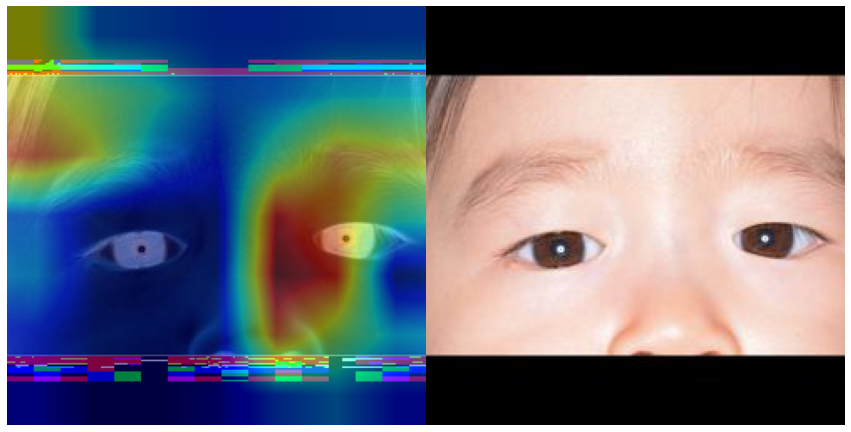



1707.jpg
label: cont
pred: cont

2501.jpg
label: cont
pred: exo


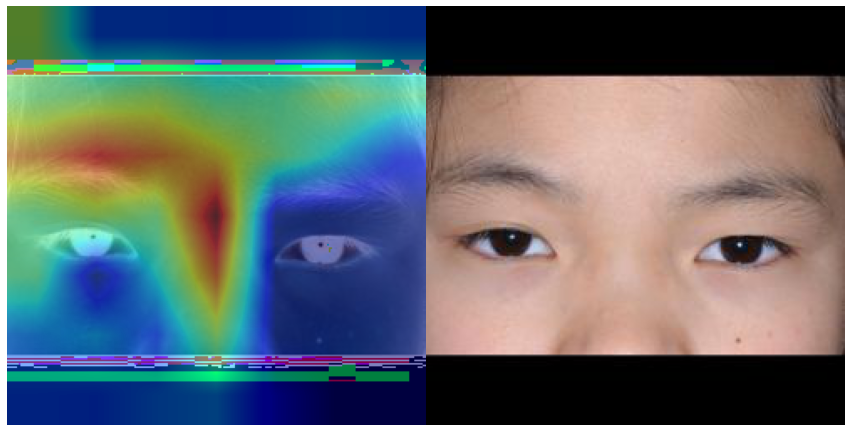



5539.jpg
label: cont
pred: cont

2155.JPG
label: cont
pred: cont

1512.JPG
label: cont
pred: cont

8027.jpg
label: cont
pred: cont

2730.jpg
label: cont
pred: cont

5533.jpg
label: cont
pred: cont

8134.jpg
label: cont
pred: exo


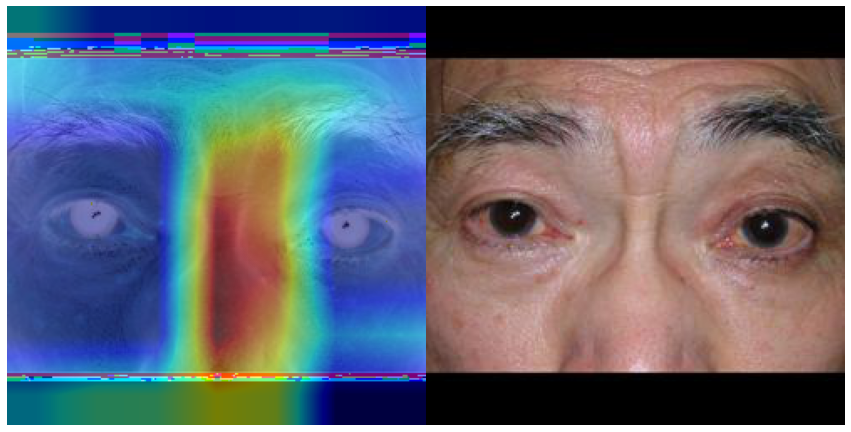



9578.jpg
label: cont
pred: exo


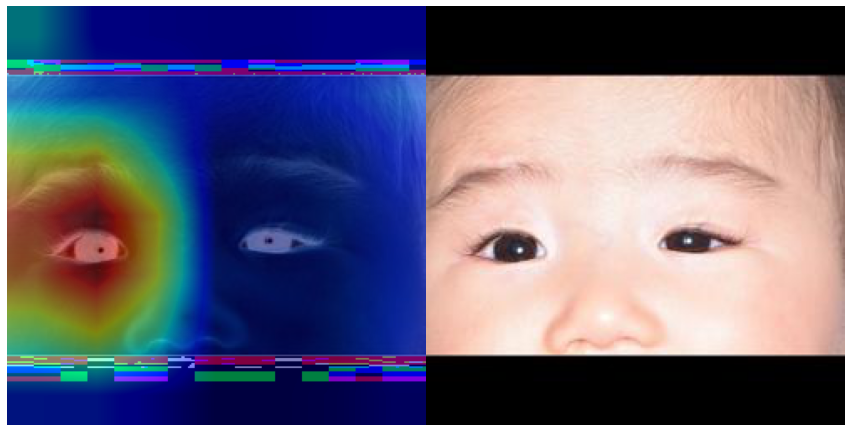



3150.jpg
label: cont
pred: cont

4800.jpg
label: cont
pred: cont

1601.jpg
label: cont
pred: cont

1522.jpg
label: cont
pred: cont

1014.JPG
label: cont
pred: cont

4692.JPG
label: cont
pred: cont

3188.JPG
label: cont
pred: cont

2537.jpg
label: cont
pred: cont

778.jpg
label: cont
pred: exo


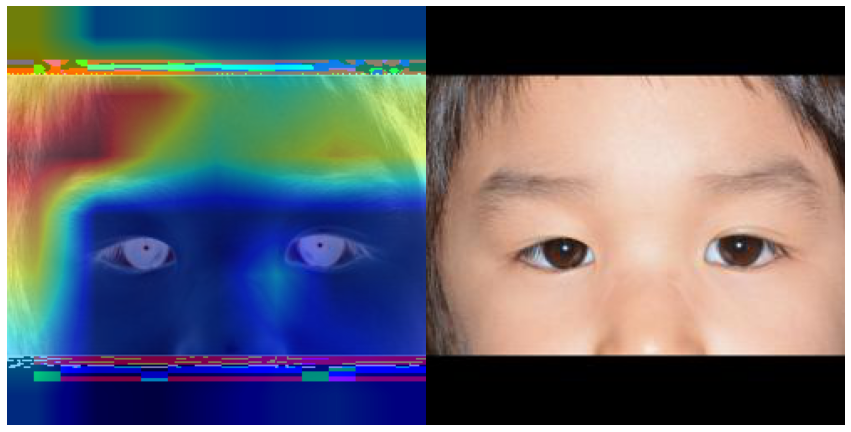



2100.jpg
label: cont
pred: cont

2014.jpg
label: cont
pred: cont

409.jpg
label: cont
pred: cont

3128.jpg
label: cont
pred: cont

8068.jpg
label: cont
pred: exo


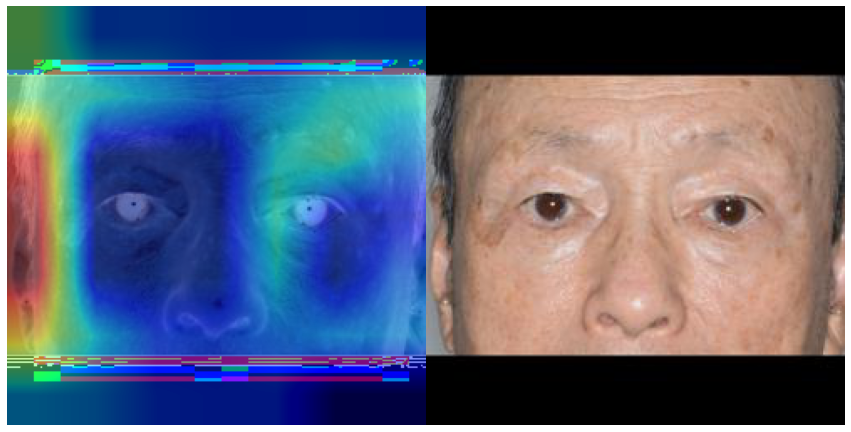



7204.JPG
label: cont
pred: cont

2102.jpg
label: cont
pred: cont

1393.jpg
label: cont
pred: cont

1134.jpg
label: cont
pred: cont

5388.jpg
label: cont
pred: exo


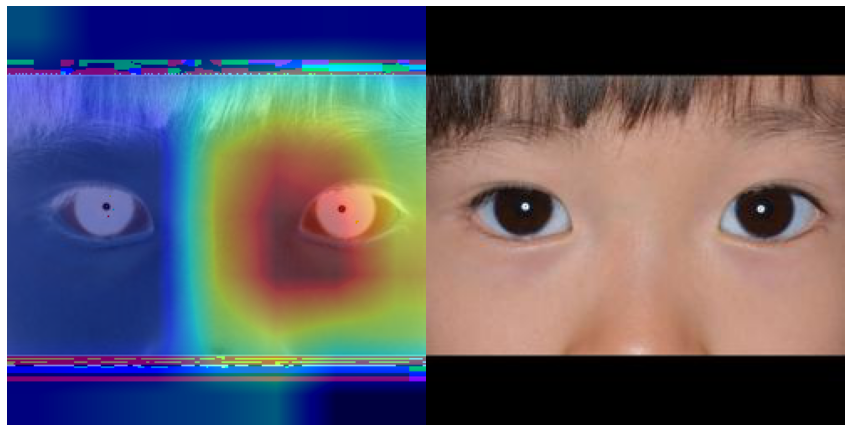



6838.jpg
label: cont
pred: cont

4246.jpg
label: cont
pred: cont

1685.jpg
label: cont
pred: cont

9734.jpg
label: cont
pred: cont

5377.jpg
label: cont
pred: cont

1222.JPG
label: cont
pred: cont

6738.jpg
label: cont
pred: cont

9559.jpg
label: cont
pred: cont

733.jpg
label: cont
pred: cont

3016.jpg
label: cont
pred: exo


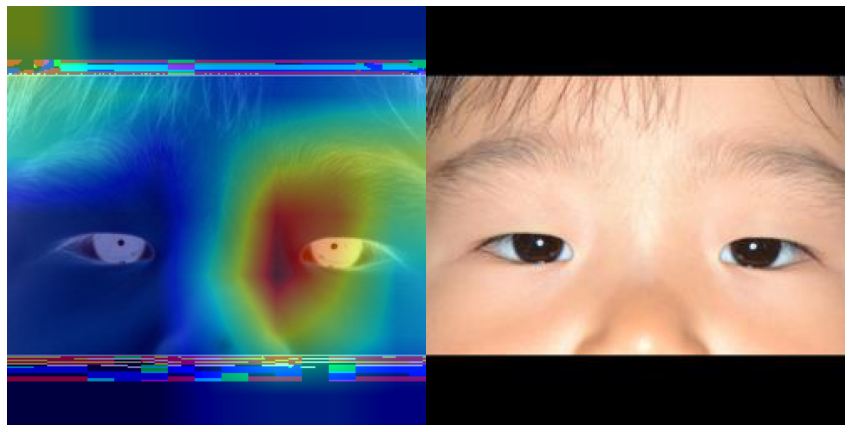



8188.jpg
label: cont
pred: cont

7660.jpg
label: cont
pred: cont

8514.jpg
label: cont
pred: cont

4671.jpg
label: cont
pred: cont

2699.jpg
label: cont
pred: cont

93.jpg
label: cont
pred: exo


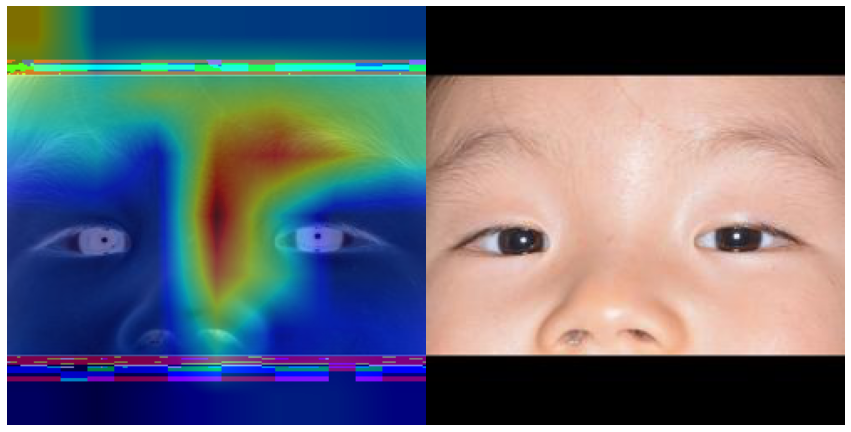



2397.jpg
label: cont
pred: cont

4230.JPG
label: cont
pred: exo


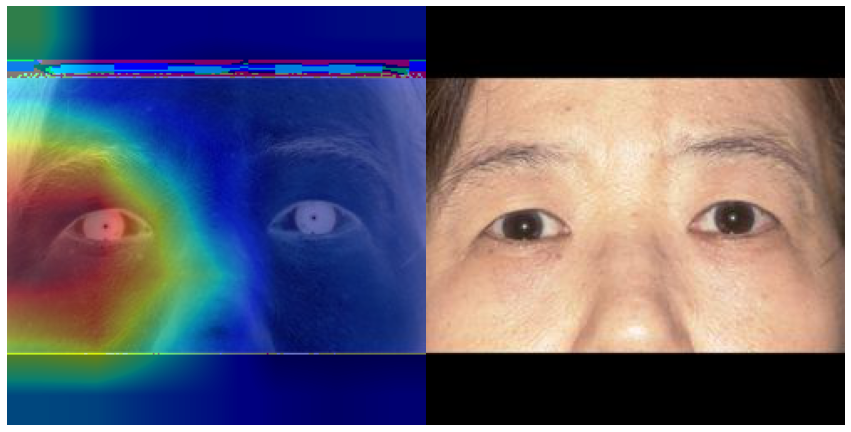



3092.jpg
label: cont
pred: exo


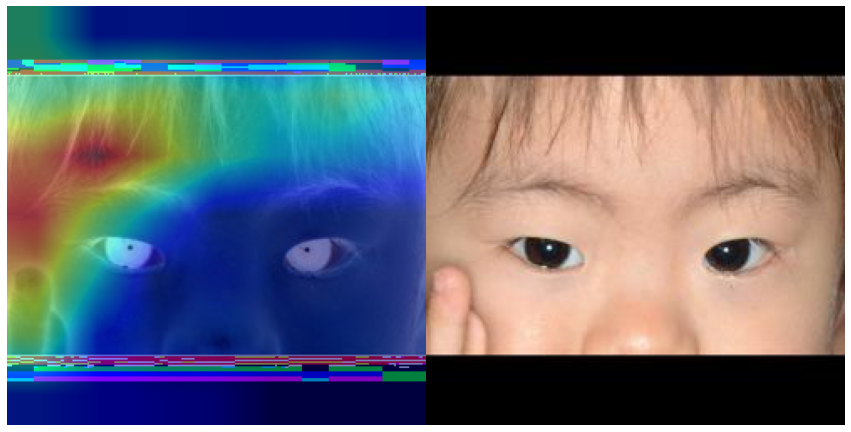



8072.jpg
label: cont
pred: exo


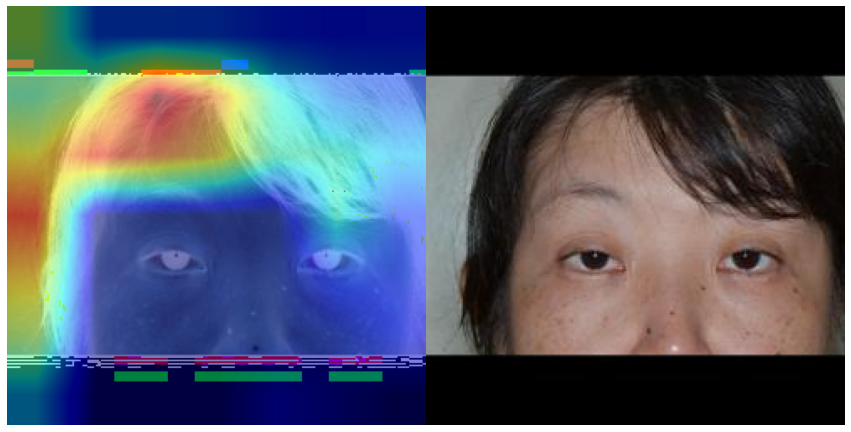



5092.jpg
label: cont
pred: cont

369.jpg
label: cont
pred: cont

5114.jpg
label: cont
pred: cont

3534.jpg
label: cont
pred: cont

8097.jpg
label: cont
pred: cont

9710.jpg
label: cont
pred: cont

8152.jpg
label: cont
pred: exo


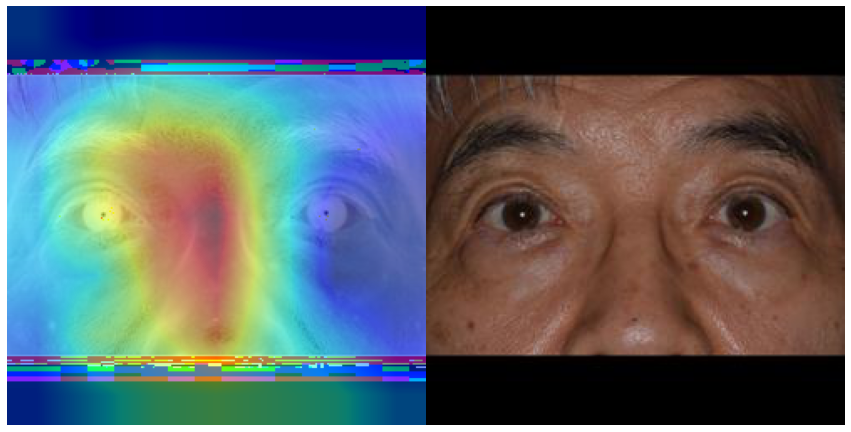



2081.jpg
label: cont
pred: exo


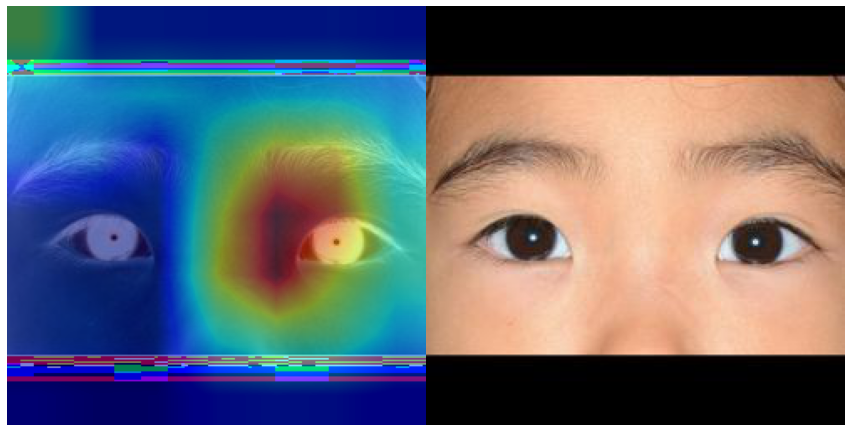



9183.jpg
label: cont
pred: cont

1674.jpg
label: cont
pred: cont

9776.jpg
label: cont
pred: cont

9332.jpg
label: cont
pred: cont

1988.jpg
label: cont
pred: cont

2214.JPG
label: cont
pred: cont

2272.JPG
label: cont
pred: cont

1621.JPG
label: cont
pred: cont

1017.jpg
label: cont
pred: cont

91.jpg
label: cont
pred: cont

3173.jpg
label: cont
pred: cont

8093.jpg
label: cont
pred: exo


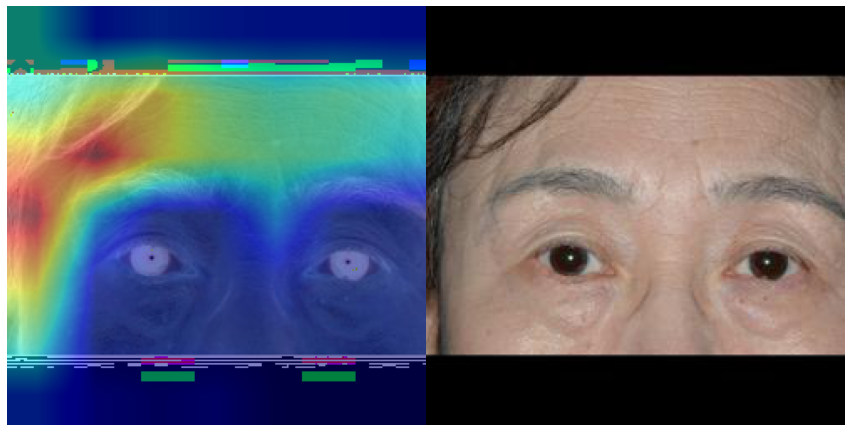



8145.JPG
label: cont
pred: cont

1882.jpg
label: cont
pred: cont

2161.jpg
label: cont
pred: cont

225.jpg
label: cont
pred: cont

9751.jpg
label: cont
pred: exo


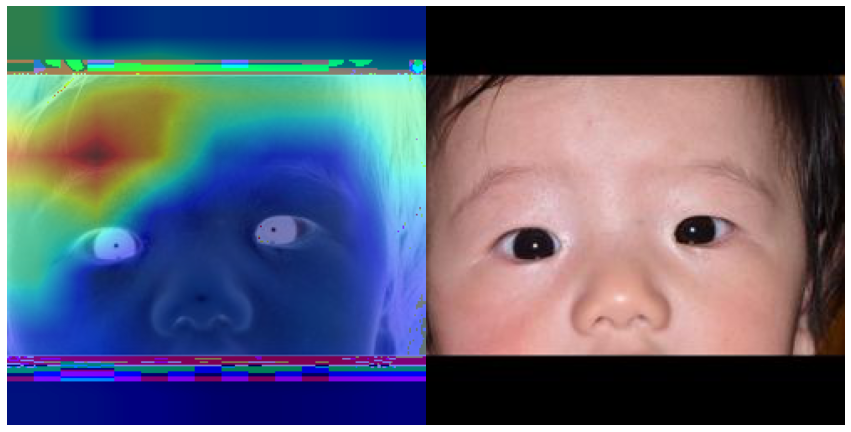



5457.jpg
label: cont
pred: cont

1291.jpg
label: cont
pred: cont

2857.jpg
label: cont
pred: cont

5077.jpg
label: cont
pred: cont

1319.jpg
label: cont
pred: cont

1960.jpg
label: cont
pred: cont

5839.JPG
label: cont
pred: cont

9349.jpg
label: cont
pred: cont

1777.jpg
label: cont
pred: exo


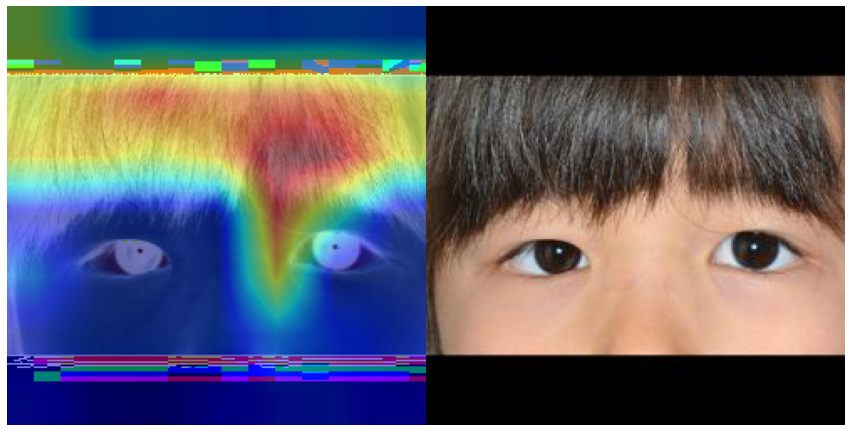



8366.jpg
label: cont
pred: cont

8380.jpg
label: cont
pred: cont

942.jpg
label: cont
pred: cont

4484.jpg
label: cont
pred: cont

3455.jpg
label: cont
pred: exo


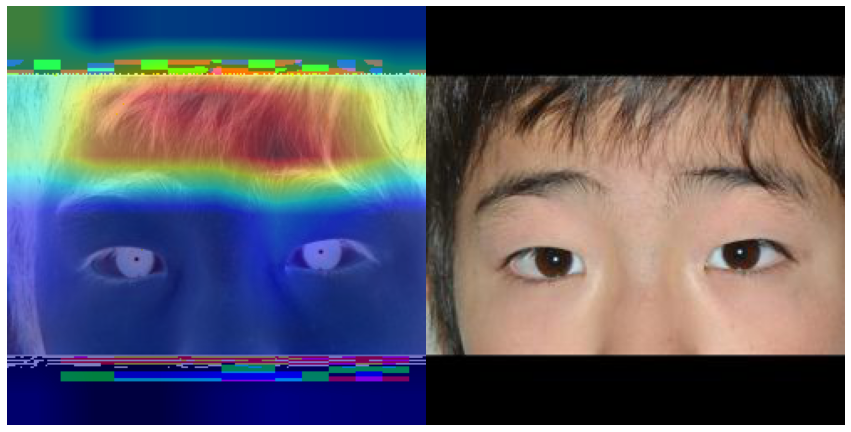



898.jpg
label: exo
pred: exo

655.jpg
label: exo
pred: cont


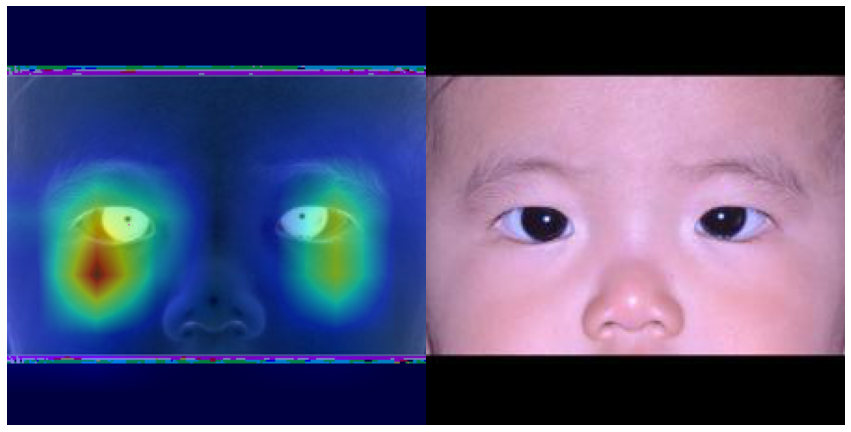



3615.jpg
label: exo
pred: exo

1421.jpg
label: exo
pred: exo

1129.jpg
label: exo
pred: exo

280.jpg
label: exo
pred: exo

4190.jpg
label: exo
pred: exo

1123.jpg
label: exo
pred: cont


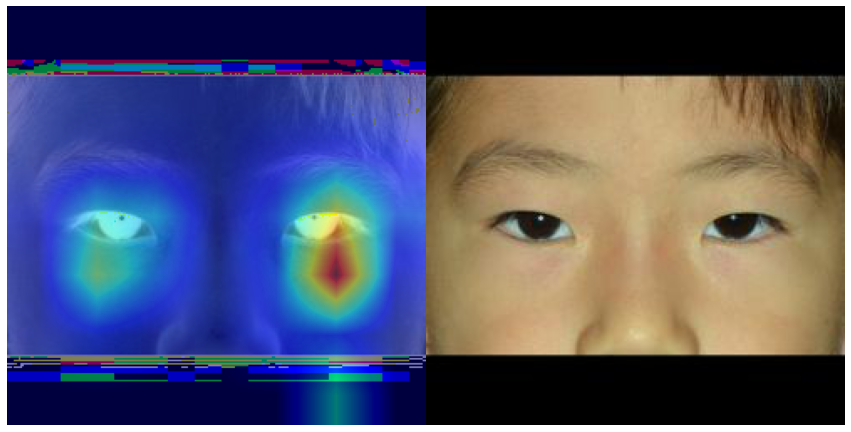



7241.JPG
label: exo
pred: exo

1782.jpg
label: exo
pred: exo

2491.jpg
label: exo
pred: exo

196.jpg
label: exo
pred: exo

2650.jpg
label: exo
pred: exo

1746.jpg
label: exo
pred: exo

1966.jpg
label: exo
pred: exo

1583.jpg
label: exo
pred: exo

1169.jpg
label: exo
pred: exo

2641.jpg
label: exo
pred: exo

3016.jpg
label: exo
pred: exo

6164.jpg
label: exo
pred: exo

2703.jpg
label: exo
pred: cont


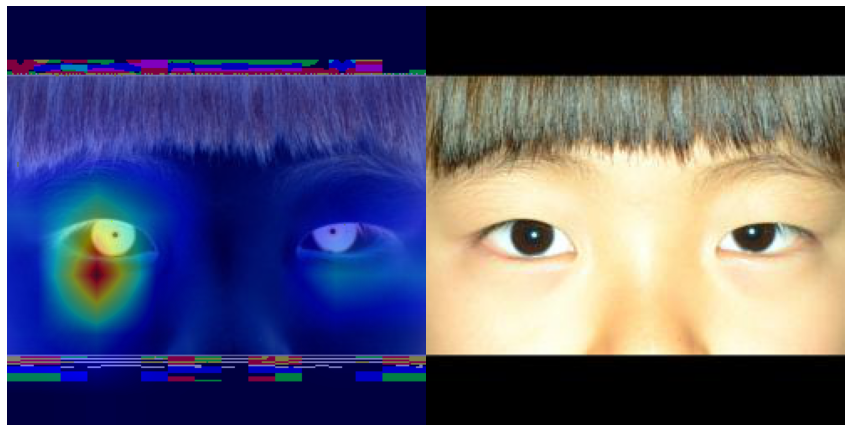



438.jpg
label: exo
pred: exo

637.jpg
label: exo
pred: exo

407.jpg
label: exo
pred: exo

7493.jpg
label: exo
pred: exo

813.jpg
label: exo
pred: exo

526.jpg
label: exo
pred: exo

734.jpg
label: exo
pred: exo

305.jpg
label: exo
pred: exo

4078.jpg
label: exo
pred: exo

972.jpg
label: exo
pred: exo

9323.jpg
label: exo
pred: exo

435.jpg
label: exo
pred: exo

1319.jpg
label: exo
pred: exo

1379.jpg
label: exo
pred: exo

322.jpg
label: exo
pred: exo

1151.jpg
label: exo
pred: exo

222.jpg
label: exo
pred: exo

3059.jpg
label: exo
pred: exo

1032.jpg
label: exo
pred: exo

2205.jpg
label: exo
pred: exo

1357.jpg
label: exo
pred: exo

549.jpg
label: exo
pred: exo

1414.jpg
label: exo
pred: cont


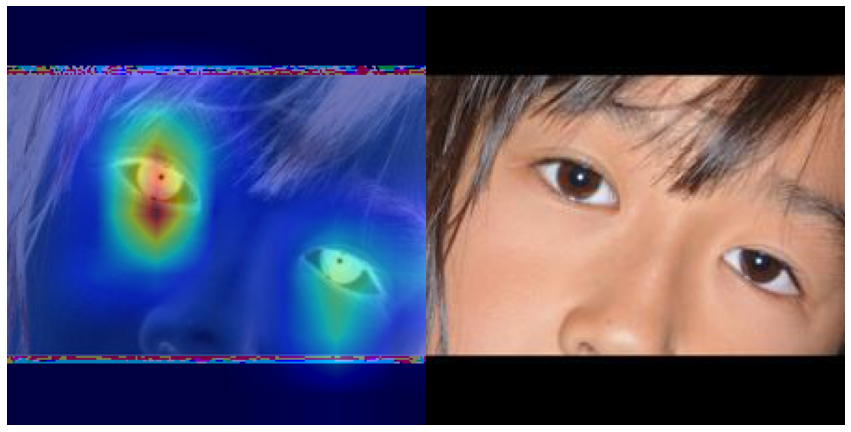



3441.jpg
label: exo
pred: exo

2235.jpg
label: exo
pred: cont


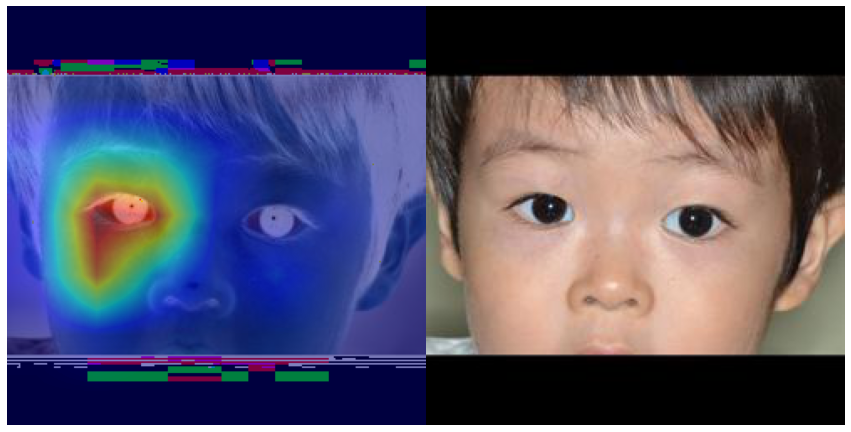



1884.jpg
label: exo
pred: exo

1611.jpg
label: exo
pred: exo

2602.jpg
label: exo
pred: exo

357.jpg
label: exo
pred: exo

1444.jpg
label: exo
pred: exo

2618.jpg
label: exo
pred: exo

1711.jpg
label: exo
pred: exo

1105.jpg
label: exo
pred: cont


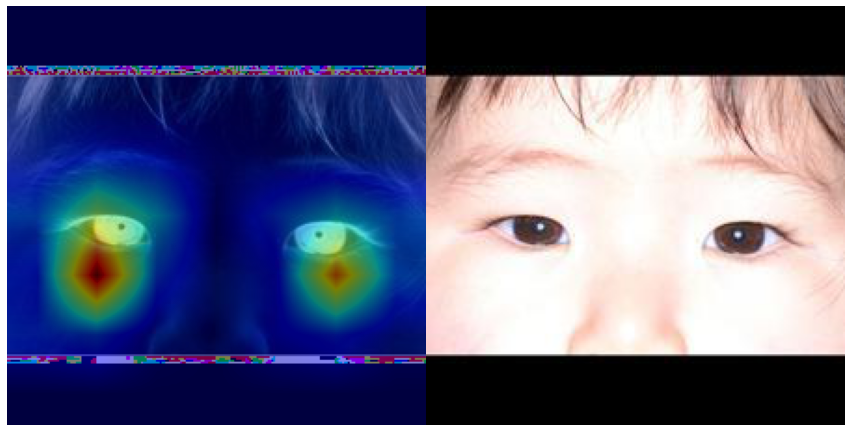



788.jpg
label: exo
pred: exo

1004.jpg
label: exo
pred: exo

478.jpg
label: exo
pred: exo

2513.jpg
label: exo
pred: exo

9372.jpg
label: exo
pred: cont


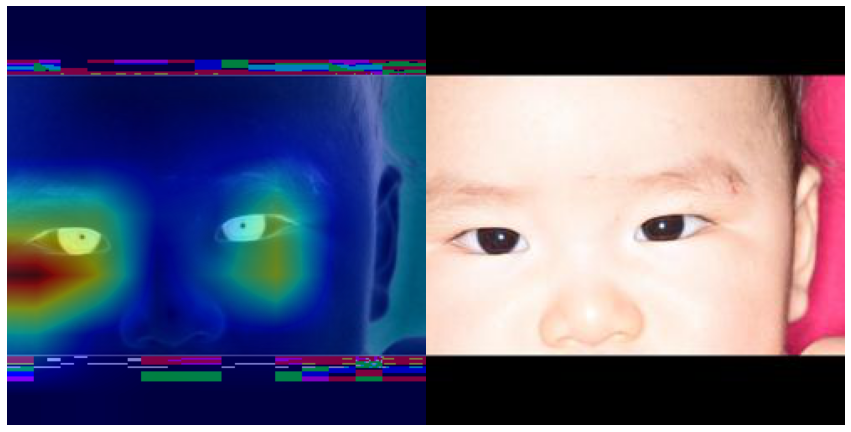



163.jpg
label: exo
pred: exo

120.jpg
label: exo
pred: exo

1532.jpg
label: exo
pred: exo

1348.jpg
label: exo
pred: exo

4291.jpg
label: exo
pred: exo

2639.jpg
label: exo
pred: exo

1825.jpg
label: exo
pred: exo

1083.jpg
label: exo
pred: exo

758.jpg
label: exo
pred: exo

840.jpg
label: exo
pred: exo

294.jpg
label: exo
pred: exo

2263.jpg
label: exo
pred: exo

82.jpg
label: exo
pred: exo

136.jpg
label: exo
pred: exo

8839.jpg
label: exo
pred: exo

1127.jpg
label: cont
pred: exo


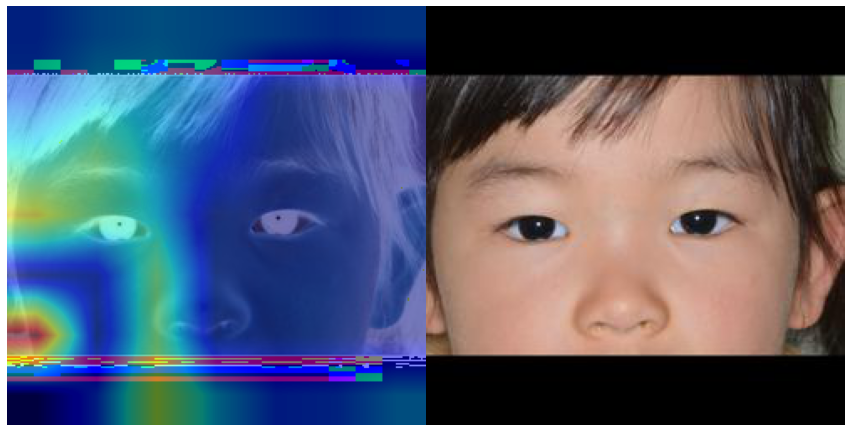



2518.JPG
label: cont
pred: cont

910.jpg
label: cont
pred: cont

8098.jpg
label: cont
pred: cont

8015.jpg
label: cont
pred: cont

2135.jpg
label: cont
pred: cont

2173.jpg
label: cont
pred: cont

1585.jpg
label: cont
pred: cont

8132.JPG
label: cont
pred: cont

9020.jpg
label: cont
pred: exo


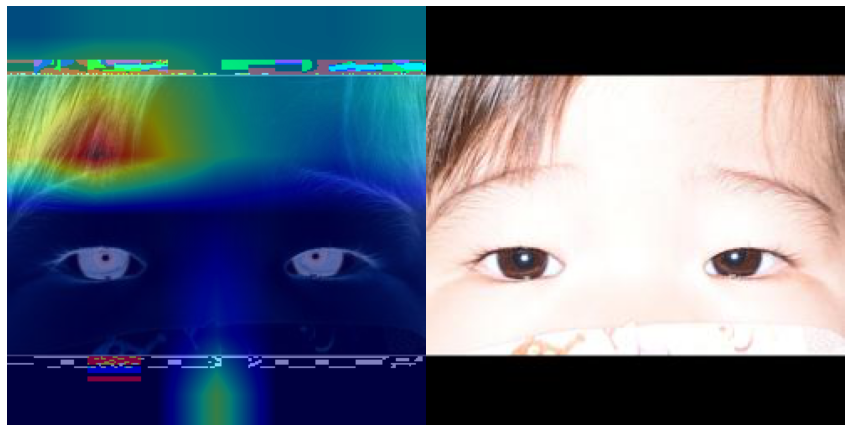



630.jpg
label: cont
pred: cont

1716.jpg
label: cont
pred: cont

4145.jpg
label: cont
pred: cont

1816.JPG
label: cont
pred: cont

6429.jpg
label: cont
pred: cont

7985.JPG
label: cont
pred: cont

1983.JPG
label: cont
pred: cont

2660.jpg
label: cont
pred: cont

1033.JPG
label: cont
pred: cont

4435.jpg
label: cont
pred: cont

3390.jpg
label: cont
pred: cont

1604.jpg
label: cont
pred: cont

8140.jpg
label: cont
pred: cont

1077.JPG
label: cont
pred: cont

1490.JPG
label: cont
pred: cont

152.JPG
label: cont
pred: cont

4737.jpg
label: cont
pred: cont

1025.jpg
label: cont
pred: cont

1213.JPG
label: cont
pred: cont

8002.jpg
label: cont
pred: cont

4163.jpg
label: cont
pred: cont

2074.jpg
label: cont
pred: cont

2494.jpg
label: cont
pred: cont

1024.jpg
label: cont
pred: cont

7908.jpg
label: cont
pred: exo


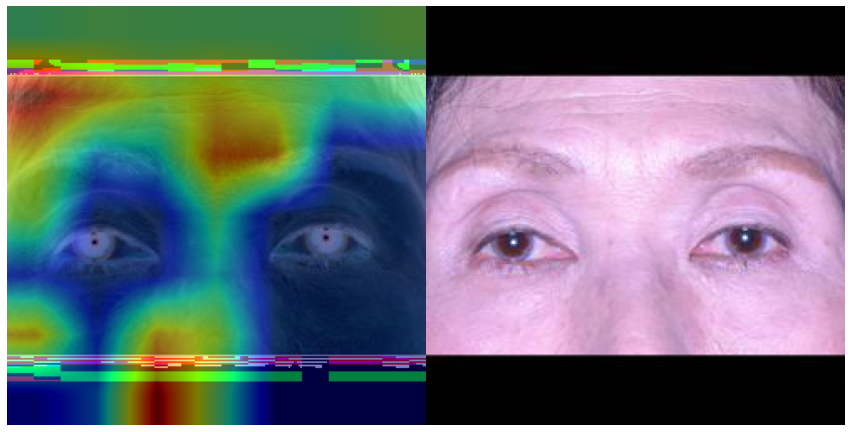



8405.jpg
label: cont
pred: cont

3298.jpg
label: cont
pred: cont

2435.JPG
label: cont
pred: cont

5889.jpg
label: cont
pred: cont

2841.JPG
label: cont
pred: cont

1785.jpg
label: cont
pred: cont

7986.jpg
label: cont
pred: exo


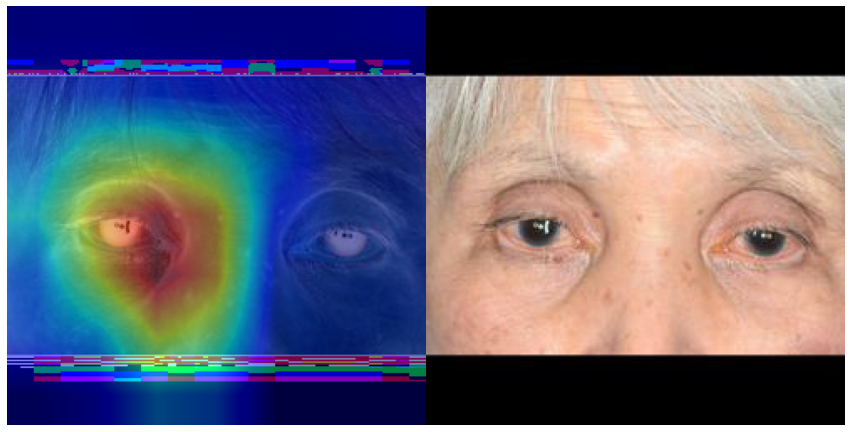



7999.JPG
label: cont
pred: cont

4788.jpg
label: cont
pred: cont

5304.jpg
label: cont
pred: cont

169.jpg
label: cont
pred: exo


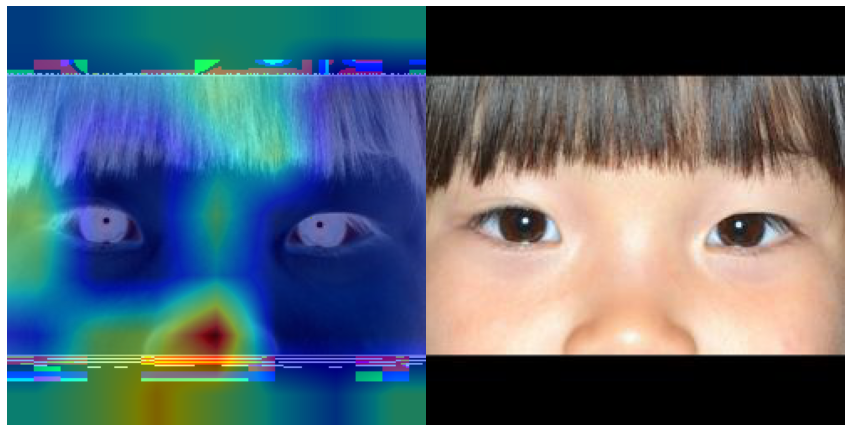



2604.JPG
label: cont
pred: cont

498.jpg
label: cont
pred: cont

8261.jpg
label: cont
pred: cont

5977.jpg
label: cont
pred: cont

1059.jpg
label: cont
pred: cont

1234.jpg
label: cont
pred: cont

6018.JPG
label: cont
pred: cont

343.jpg
label: cont
pred: cont

7988.jpg
label: cont
pred: cont

8623.jpg
label: cont
pred: cont

234.jpg
label: cont
pred: cont

7906.JPG
label: cont
pred: cont

1888.jpg
label: cont
pred: cont

3586.jpg
label: cont
pred: exo


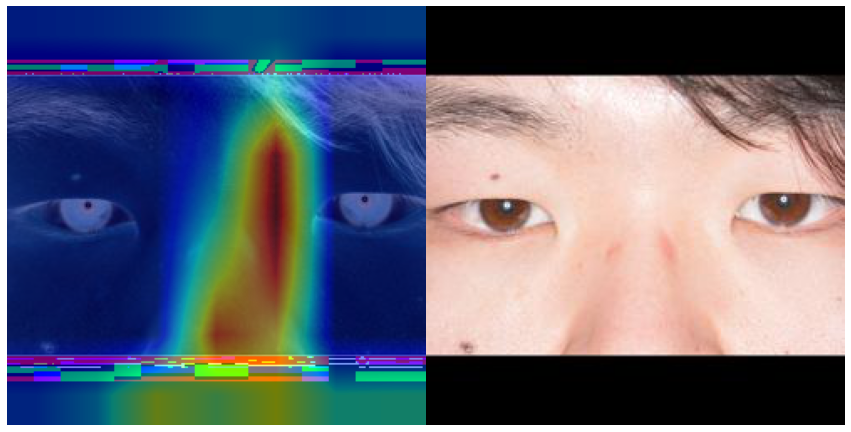



183.jpg
label: cont
pred: cont

2162.jpg
label: cont
pred: cont

308.jpg
label: cont
pred: cont

8183.jpg
label: cont
pred: cont

9210.jpg
label: cont
pred: cont

9604.jpg
label: cont
pred: cont

3013.JPG
label: cont
pred: cont

1443.JPG
label: cont
pred: cont

5587.jpg
label: cont
pred: cont

6132.jpg
label: cont
pred: cont

827.jpg
label: cont
pred: cont

2298.jpg
label: cont
pred: cont

1656.jpg
label: cont
pred: cont

1927.JPG
label: cont
pred: cont

1574.jpg
label: cont
pred: cont

4498.jpg
label: cont
pred: cont

1462.JPG
label: cont
pred: cont

7960.jpg
label: cont
pred: cont

2048.jpg
label: cont
pred: cont

1992.jpg
label: cont
pred: cont

7886.jpg
label: cont
pred: cont

2525.JPG
label: cont
pred: cont

4387.JPG
label: cont
pred: cont

1696.JPG
label: cont
pred: cont

1883.jpg
label: cont
pred: cont

2044.jpg
label: cont
pred: cont

7972.JPG
label: cont
pred: cont

4095.jpg
label: cont
pred: cont

4027.JPG
label: cont
pred: exo


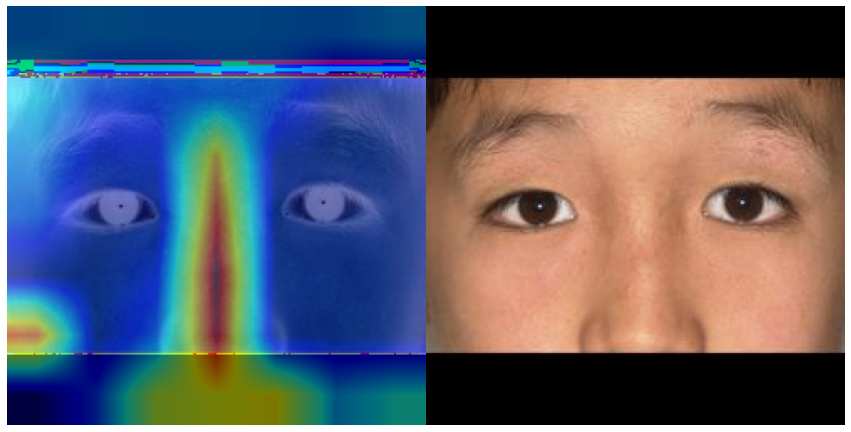



844.jpg
label: exo
pred: exo

725.jpg
label: exo
pred: exo

1716.jpg
label: exo
pred: exo

918.jpg
label: exo
pred: exo

1626.jpg
label: exo
pred: exo

2449.jpg
label: exo
pred: exo

1049.jpg
label: exo
pred: exo

159.jpg
label: exo
pred: exo

3231.jpg
label: exo
pred: exo

5912.jpg
label: exo
pred: exo

359.jpg
label: exo
pred: exo

1102.jpg
label: exo
pred: exo

8551.jpg
label: exo
pred: exo

2621.jpg
label: exo
pred: exo

2425.jpg
label: exo
pred: exo

2463.jpg
label: exo
pred: exo

1654.jpg
label: exo
pred: exo

2581.jpg
label: exo
pred: exo

125.jpg
label: exo
pred: exo

2383.jpg
label: exo
pred: exo

7891.jpg
label: exo
pred: exo

2257.jpg
label: exo
pred: exo

2270.jpg
label: exo
pred: exo

1630.jpg
label: exo
pred: exo

1888.jpg
label: exo
pred: exo

1031.jpg
label: exo
pred: exo

7152.jpg
label: exo
pred: cont


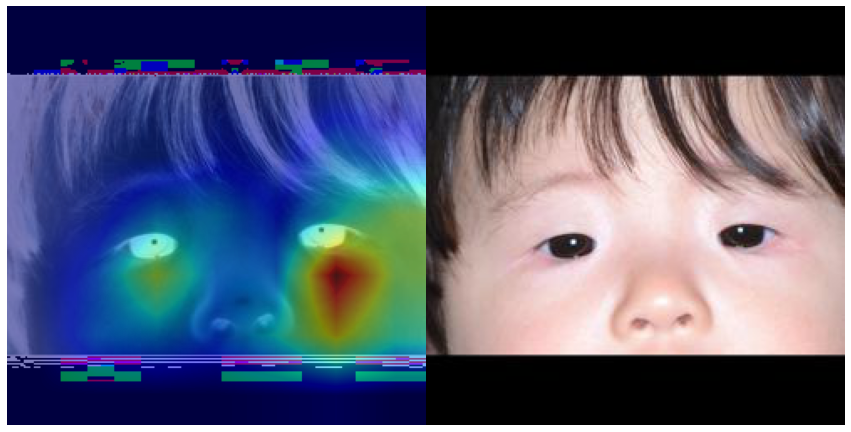



1387.jpg
label: exo
pred: exo

2462.jpg
label: exo
pred: exo

1172.jpg
label: exo
pred: exo

1507.jpg
label: exo
pred: exo

1480.jpg
label: exo
pred: exo

9604.jpg
label: exo
pred: cont


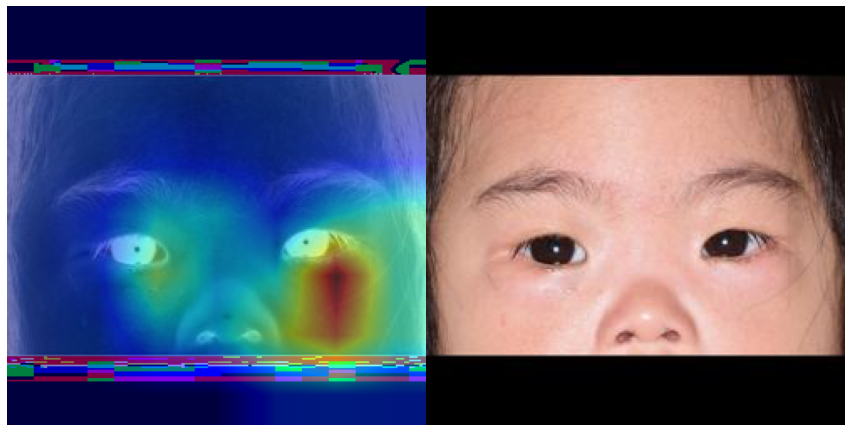



9607.jpg
label: exo
pred: cont


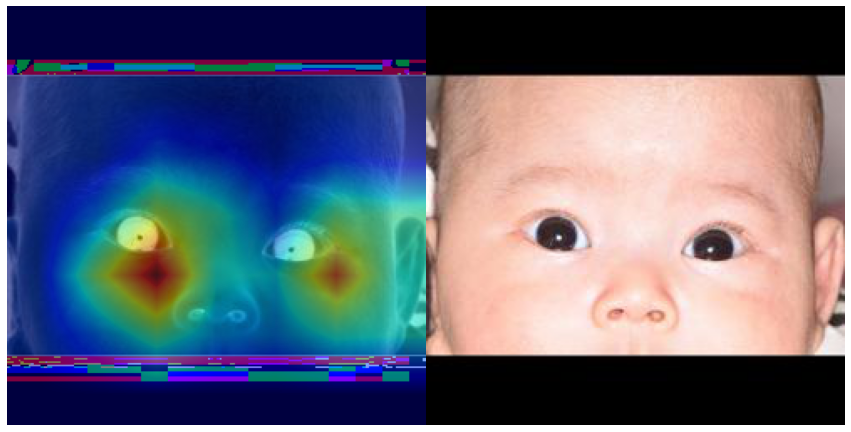



1674.jpg
label: exo
pred: exo

2212.jpg
label: exo
pred: exo

312.jpg
label: exo
pred: exo

213.jpg
label: exo
pred: exo

926.jpg
label: exo
pred: exo

2632.jpg
label: exo
pred: exo

4203.jpg
label: exo
pred: exo

2234.jpg
label: exo
pred: exo

162.jpg
label: exo
pred: exo

2072.jpg
label: exo
pred: exo

2100.jpg
label: exo
pred: exo

792.jpg
label: exo
pred: exo

1135.jpg
label: exo
pred: cont


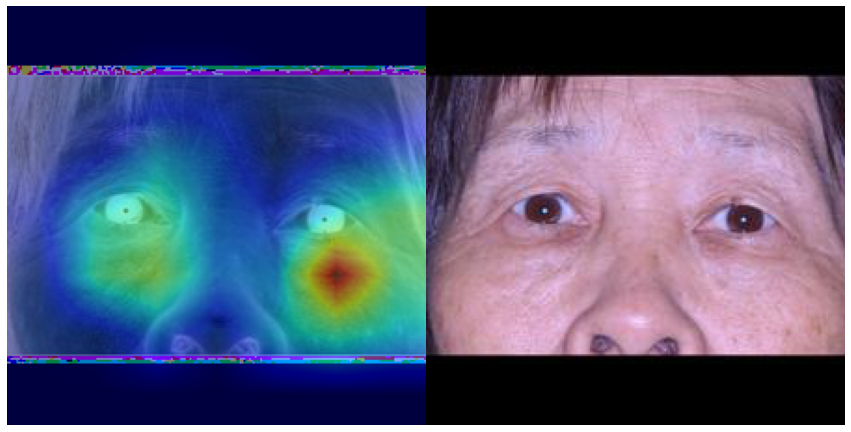



2685.jpg
label: exo
pred: exo

1485.jpg
label: exo
pred: exo

892.jpg
label: exo
pred: exo

9444.jpg
label: exo
pred: exo

2381.jpg
label: exo
pred: exo

1992.jpg
label: exo
pred: exo

2339.jpg
label: exo
pred: exo

929.jpg
label: exo
pred: exo

9043.jpg
label: exo
pred: exo

453.jpg
label: exo
pred: exo

2020.jpg
label: exo
pred: exo

716.jpg
label: exo
pred: exo

1189.jpg
label: exo
pred: cont


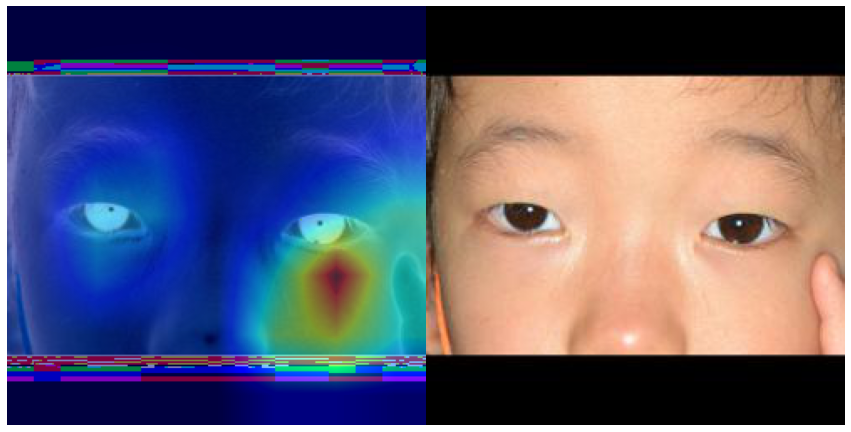



2415.jpg
label: exo
pred: exo

816.jpg
label: exo
pred: exo

1996.jpg
label: exo
pred: exo

868.jpg
label: exo
pred: exo

473.jpg
label: exo
pred: exo

3465.jpg
label: exo
pred: cont


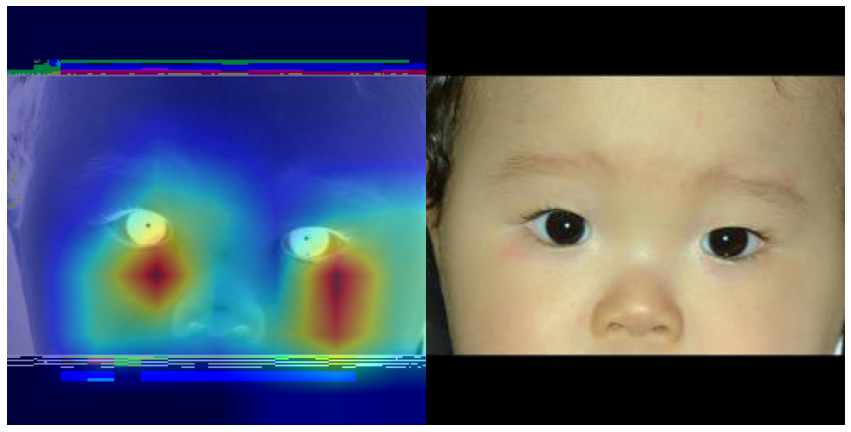



307.jpg
label: exo
pred: exo

9089.jpg
label: exo
pred: exo

921.jpg
label: exo
pred: exo

2397.jpg
label: exo
pred: exo

2200.jpg
label: exo
pred: exo

1428.jpg
label: exo
pred: exo

1437.jpg
label: exo
pred: exo

9622.jpg
label: exo
pred: exo

2381.jpg
label: cont
pred: cont

2107.JPG
label: cont
pred: cont

2947.JPG
label: cont
pred: cont

5143.jpg
label: cont
pred: cont

7952.jpg
label: cont
pred: cont

126.jpg
label: cont
pred: cont

1598.jpg
label: cont
pred: cont

5606.jpg
label: cont
pred: cont

1985.jpg
label: cont
pred: cont

4797.jpg
label: cont
pred: cont

6685.JPG
label: cont
pred: cont

8117.jpg
label: cont
pred: cont

3300.jpg
label: cont
pred: cont

5231.jpg
label: cont
pred: cont

4733.jpg
label: cont
pred: cont

97.jpg
label: cont
pred: cont

5603.jpg
label: cont
pred: cont

3009.jpg
label: cont
pred: cont

8100.JPG
label: cont
pred: cont

310.jpg
label: cont
pred: cont

2129.jpg
label: cont
pred: cont

4021.jpg
label: cont
pred: cont

7937.jpg
label: cont
pred: con

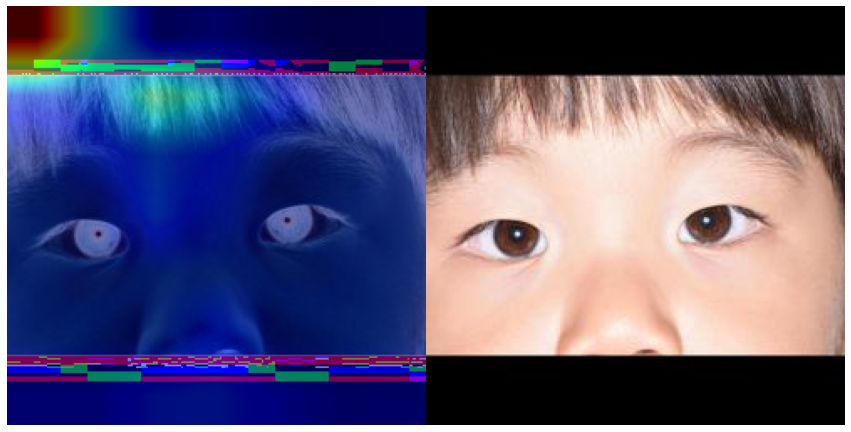



4642.jpg
label: cont
pred: cont

930.jpg
label: cont
pred: cont

1009.jpg
label: cont
pred: cont

5169.jpg
label: cont
pred: cont

1012.jpg
label: cont
pred: cont

3410.JPG
label: cont
pred: cont

8088.jpg
label: cont
pred: cont

5981.jpg
label: cont
pred: cont

9179.jpg
label: cont
pred: cont

9629.jpg
label: cont
pred: cont

8471.jpg
label: cont
pred: cont

7401.jpg
label: cont
pred: cont

1405.JPG
label: cont
pred: cont

5059.jpg
label: cont
pred: cont

4745.jpg
label: cont
pred: cont

8019.jpg
label: cont
pred: cont

417.jpg
label: cont
pred: cont

8017.jpg
label: cont
pred: cont

8285.jpg
label: cont
pred: cont

9417.jpg
label: cont
pred: cont

1230.JPG
label: cont
pred: exo


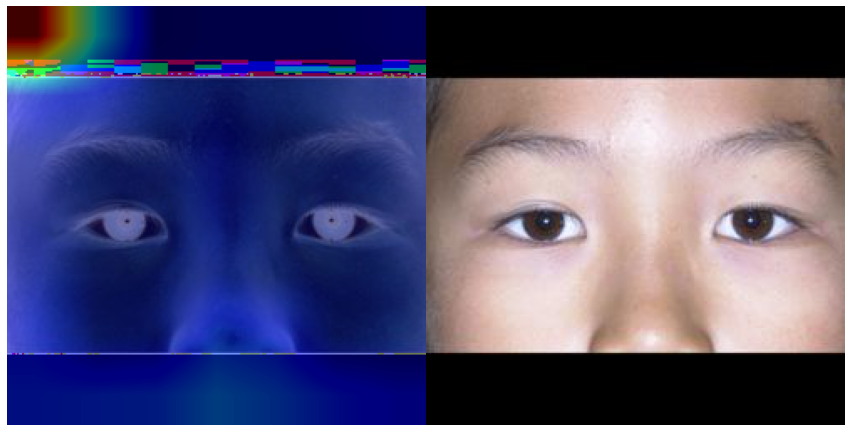



1765.JPG
label: cont
pred: cont

1082.jpg
label: cont
pred: cont

5058.jpg
label: cont
pred: cont

6843.JPG
label: cont
pred: cont

4913.jpg
label: cont
pred: cont

47.jpg
label: cont
pred: cont

4238.jpg
label: cont
pred: cont

7057.jpg
label: cont
pred: cont

914.jpg
label: cont
pred: cont

8627.jpg
label: cont
pred: cont

9594.jpg
label: cont
pred: cont

4906.jpg
label: cont
pred: cont

1651.jpg
label: cont
pred: cont

6285.JPG
label: cont
pred: cont

8024.jpg
label: cont
pred: cont

4549.jpg
label: cont
pred: cont

9595.jpg
label: cont
pred: cont

1023.jpg
label: cont
pred: cont

2385.jpg
label: cont
pred: cont

813.jpg
label: cont
pred: cont

8256.jpg
label: cont
pred: cont

2424.jpg
label: cont
pred: cont

5727.jpg
label: cont
pred: cont

4762.jpg
label: cont
pred: cont

2134.jpg
label: cont
pred: cont

4869.jpg
label: cont
pred: cont

1459.jpg
label: cont
pred: cont

116.JPG
label: cont
pred: cont

1434.JPG
label: cont
pred: cont

6103.jpg
label: cont
pred: cont

8581.jpg
labe

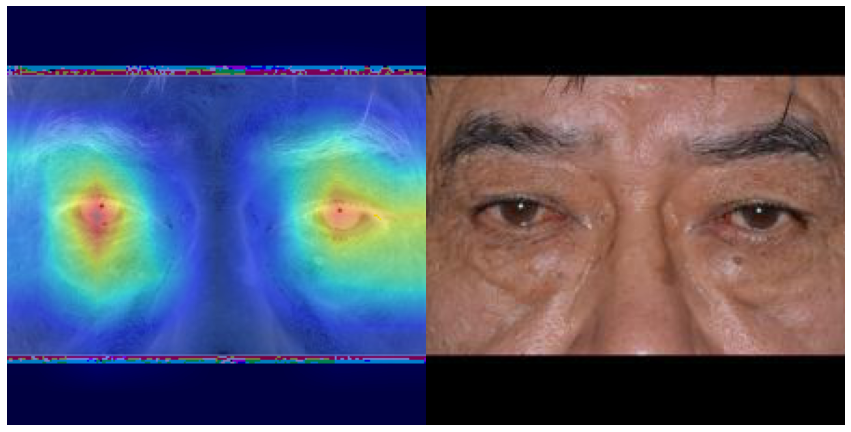



2296.jpg
label: exo
pred: exo

1804.jpg
label: exo
pred: exo

2690.jpg
label: exo
pred: exo

1350.jpg
label: exo
pred: exo

445.jpg
label: exo
pred: exo

1617.jpg
label: exo
pred: exo

3789.jpg
label: exo
pred: exo

3574.jpg
label: exo
pred: exo

1465.jpg
label: exo
pred: exo

9214.jpg
label: exo
pred: exo

7513.jpg
label: exo
pred: exo

2669.jpg
label: exo
pred: exo

3239.jpg
label: exo
pred: exo

7933.jpg
label: exo
pred: cont


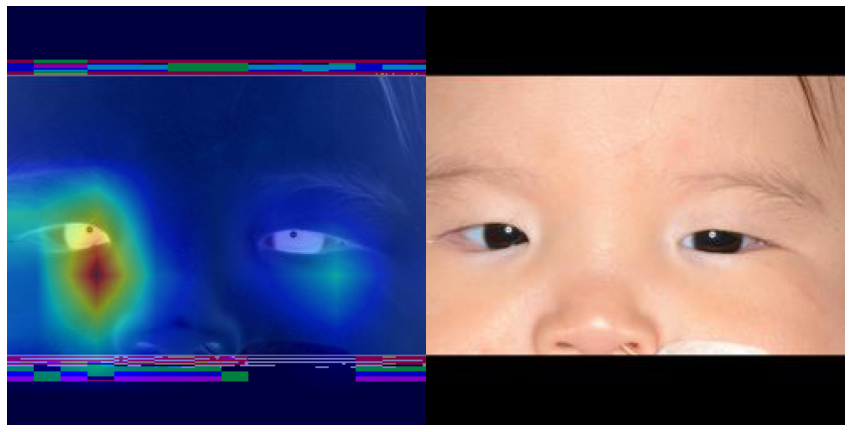



2637.jpg
label: exo
pred: exo

2135.jpg
label: exo
pred: exo

1294.jpg
label: exo
pred: exo

8977.jpg
label: exo
pred: exo

1833.jpg
label: exo
pred: exo

1505.jpg
label: exo
pred: exo

9264.jpg
label: exo
pred: cont


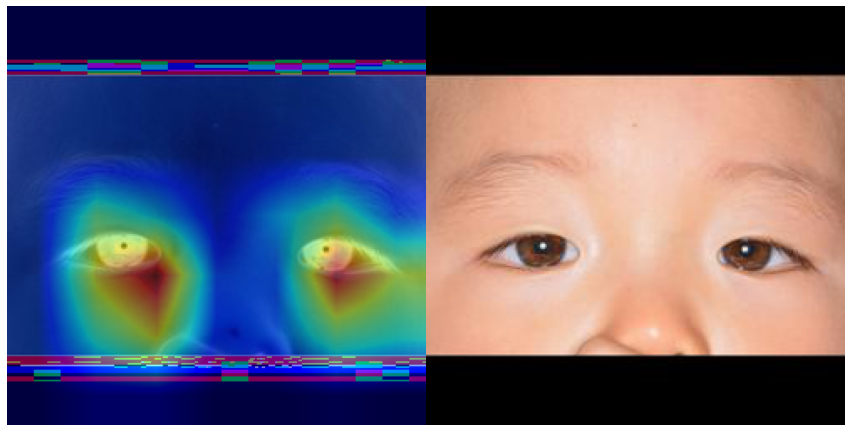



186.jpg
label: exo
pred: exo

8345.jpg
label: exo
pred: exo

7500.jpg
label: exo
pred: exo

257.jpg
label: exo
pred: exo

3116.jpg
label: exo
pred: exo

735.jpg
label: exo
pred: exo

1155.jpg
label: exo
pred: exo

1813.jpg
label: exo
pred: cont


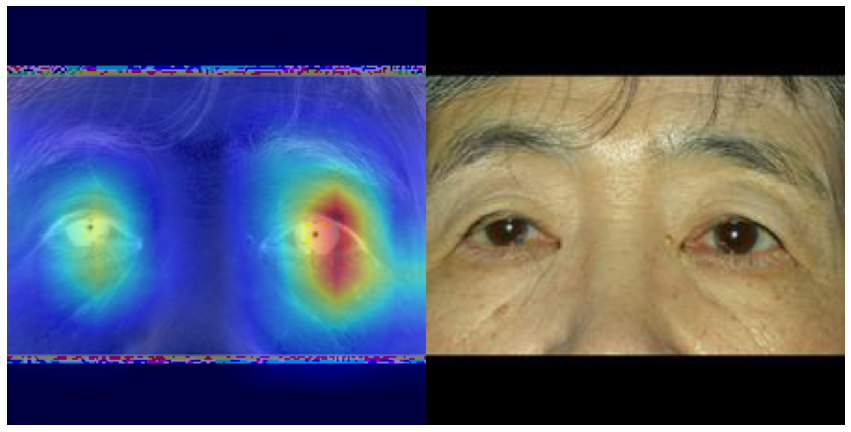



8194.jpg
label: exo
pred: exo

1367.jpg
label: exo
pred: exo

666.jpg
label: exo
pred: exo

2609.jpg
label: exo
pred: exo

1546.jpg
label: exo
pred: exo

1917.jpg
label: exo
pred: cont


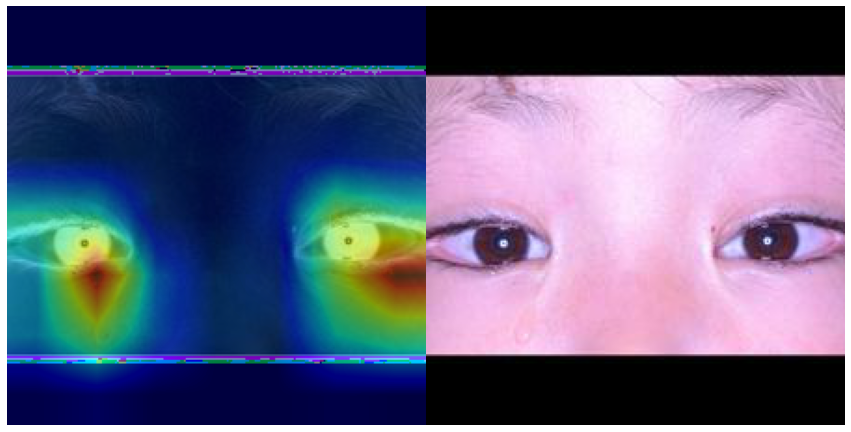



994.jpg
label: exo
pred: exo

135.jpg
label: exo
pred: exo

2501.jpg
label: exo
pred: exo

1788.jpg
label: exo
pred: exo

429.jpg
label: exo
pred: cont


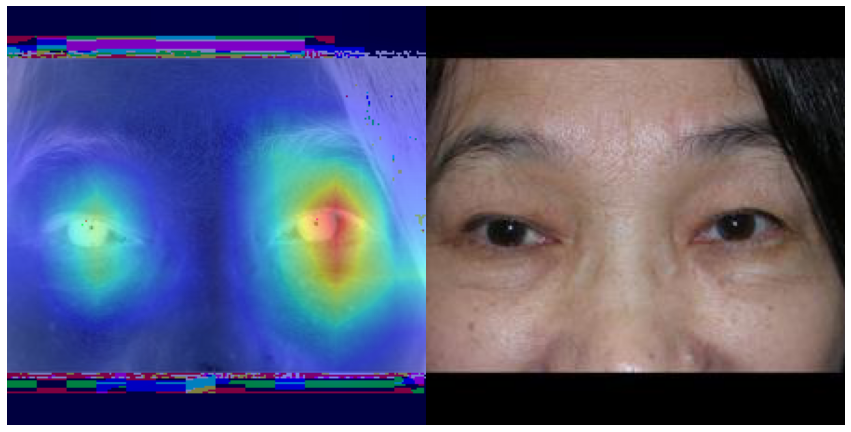



6817.jpg
label: exo
pred: exo

1775.jpg
label: exo
pred: exo

1708.jpg
label: exo
pred: exo

254.jpg
label: exo
pred: exo

617.jpg
label: exo
pred: exo

49.jpg
label: exo
pred: exo

589.jpg
label: exo
pred: exo

1679.jpg
label: exo
pred: exo

4437.jpg
label: exo
pred: exo

1343.jpg
label: exo
pred: exo

1015.JPG
label: exo
pred: exo

1099.jpg
label: exo
pred: exo

608.jpg
label: exo
pred: exo

894.jpg
label: exo
pred: exo

1846.jpg
label: exo
pred: exo

790.jpg
label: exo
pred: exo

3583.jpg
label: exo
pred: exo

949.jpg
label: exo
pred: exo

423.jpg
label: exo
pred: exo

8366.jpg
label: exo
pred: cont


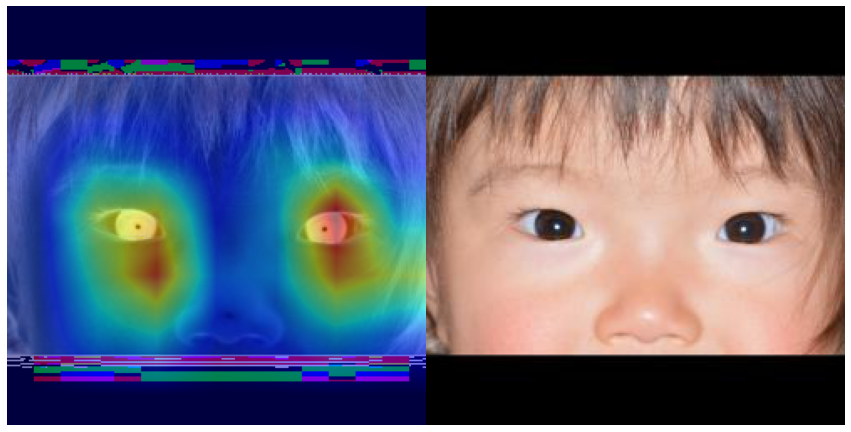



414.jpg
label: exo
pred: exo

1216.jpg
label: exo
pred: exo

1362.jpg
label: exo
pred: exo

1789.jpg
label: exo
pred: exo

71.jpg
label: exo
pred: exo

1919.jpg
label: exo
pred: exo

6819.jpg
label: exo
pred: exo

761.jpg
label: exo
pred: exo

2069.jpg
label: exo
pred: exo

7040.jpg
label: exo
pred: exo

2770.jpg
label: exo
pred: exo

6862.jpg
label: exo
pred: exo

4756.jpg
label: cont
pred: cont

5196.JPG
label: cont
pred: cont

7995.jpg
label: cont
pred: cont

2828.jpg
label: cont
pred: cont

1730.jpg
label: cont
pred: cont

4923.jpg
label: cont
pred: cont

5731.jpg
label: cont
pred: cont

2832.jpg
label: cont
pred: cont

8118.jpg
label: cont
pred: cont

8149.jpg
label: cont
pred: cont

4664.jpg
label: cont
pred: cont

8728.jpg
label: cont
pred: cont

2101.JPG
label: cont
pred: cont

4462.jpg
label: cont
pred: cont

9469.jpg
label: cont
pred: exo


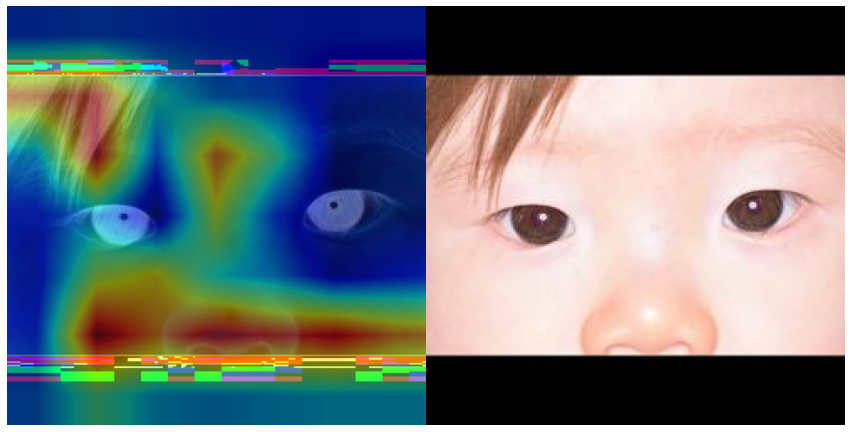



7400.jpg
label: cont
pred: cont

7998.jpg
label: cont
pred: cont

6454.jpg
label: cont
pred: cont

959.jpg
label: cont
pred: cont

1193.jpg
label: cont
pred: cont

5783.JPG
label: cont
pred: cont

2002.jpg
label: cont
pred: cont

8094.jpg
label: cont
pred: cont

8008.jpg
label: cont
pred: exo


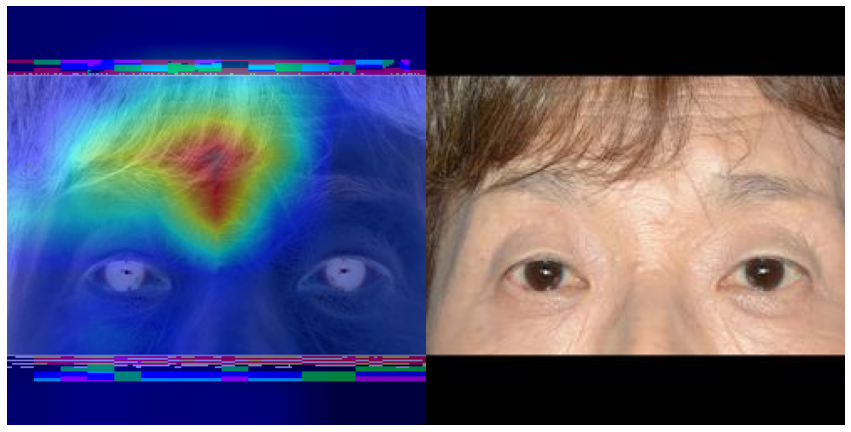



201.JPG
label: cont
pred: cont

5097.jpg
label: cont
pred: cont

7424.jpg
label: cont
pred: cont

2212.jpg
label: cont
pred: cont

2444.jpg
label: cont
pred: cont

2575.jpg
label: cont
pred: cont

2031.jpg
label: cont
pred: cont

1461.jpg
label: cont
pred: cont

5485.JPG
label: cont
pred: cont

8874.jpg
label: cont
pred: cont

8010.jpg
label: cont
pred: cont

1162.JPG
label: cont
pred: cont

8120.JPG
label: cont
pred: cont

1372.jpg
label: cont
pred: cont

3206.jpg
label: cont
pred: cont

327.jpg
label: cont
pred: cont

303.jpg
label: cont
pred: cont

7954.jpg
label: cont
pred: cont

7111.jpg
label: cont
pred: cont

9105.jpg
label: cont
pred: cont

2286.jpg
label: cont
pred: cont

2394.JPG
label: cont
pred: cont

6000.jpg
label: cont
pred: cont

2069.jpg
label: cont
pred: cont

9487.jpg
label: cont
pred: cont

786.jpg
label: cont
pred: cont

620.jpg
label: cont
pred: cont

1295.jpg
label: cont
pred: cont

8304.jpg
label: cont
pred: cont

2856.jpg
label: cont
pred: cont

4862.JPG
labe

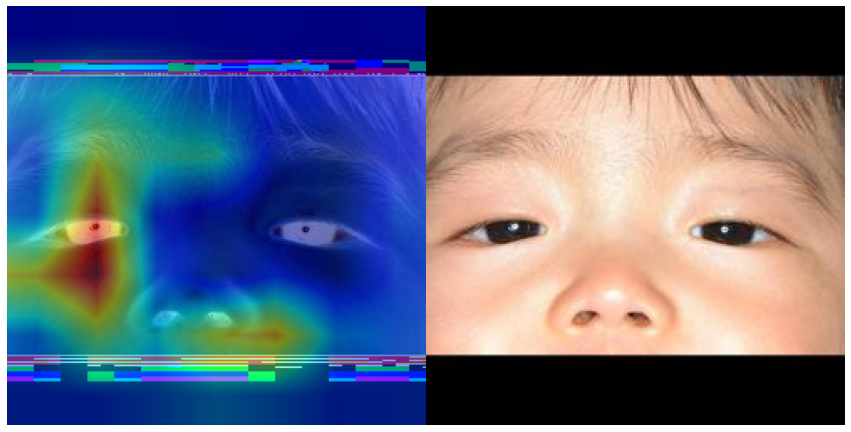



1873.jpg
label: cont
pred: cont

2276.JPG
label: cont
pred: cont

123.jpg
label: cont
pred: cont

137.jpg
label: cont
pred: cont

2462.jpg
label: cont
pred: cont

2675.jpg
label: cont
pred: cont

1897.jpg
label: cont
pred: cont

1414.jpg
label: cont
pred: cont

1256.JPG
label: cont
pred: cont

145.JPG
label: cont
pred: cont

1688.jpg
label: cont
pred: cont

9338.jpg
label: cont
pred: cont

1573.JPG
label: cont
pred: cont

5071.jpg
label: cont
pred: cont

4760.jpg
label: cont
pred: cont

8266.jpg
label: cont
pred: cont

6717.jpg
label: cont
pred: exo


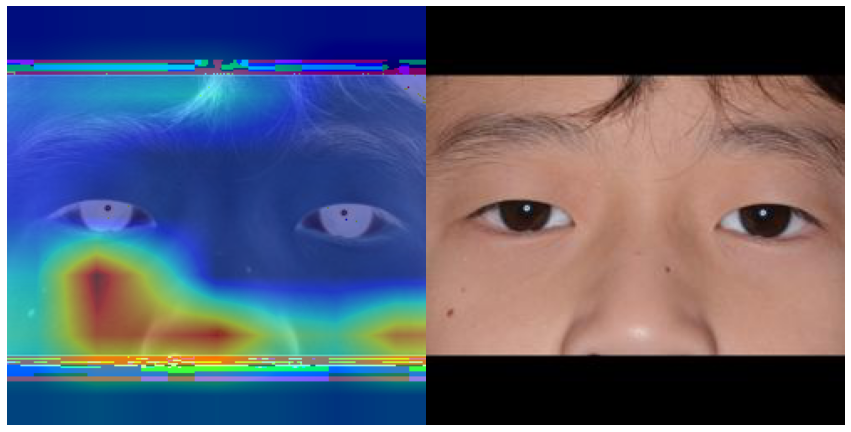



5223.jpg
label: cont
pred: cont

5390.jpg
label: cont
pred: exo


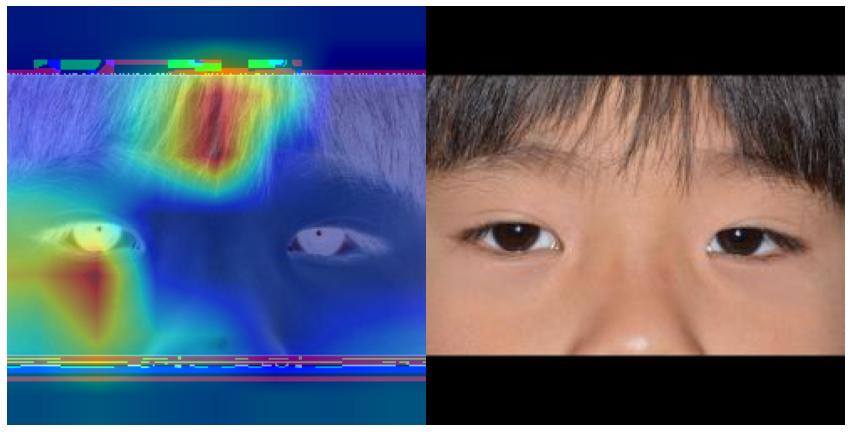



5698.jpg
label: cont
pred: cont

4731.jpg
label: cont
pred: cont

1580.jpg
label: cont
pred: exo


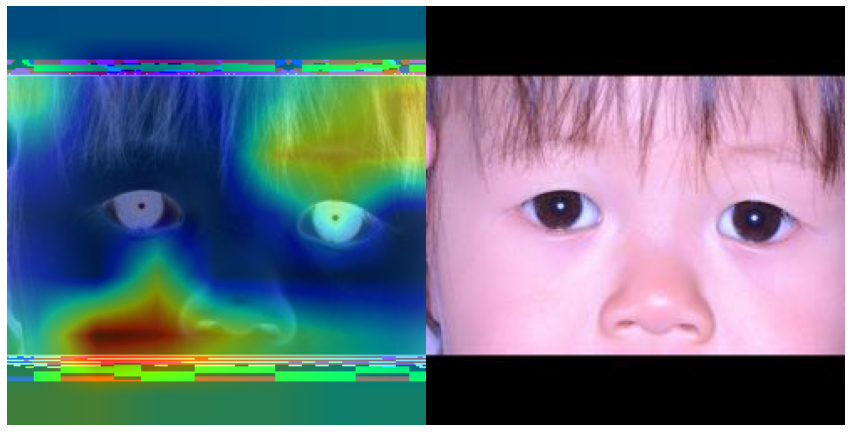



4796.jpg
label: cont
pred: cont

8092.jpg
label: cont
pred: cont

2183.jpg
label: cont
pred: cont

7910.jpg
label: cont
pred: cont

4603.jpg
label: cont
pred: cont

8102.jpg
label: cont
pred: cont

6868.jpg
label: cont
pred: cont

8137.jpg
label: cont
pred: cont

6173.jpg
label: exo
pred: cont


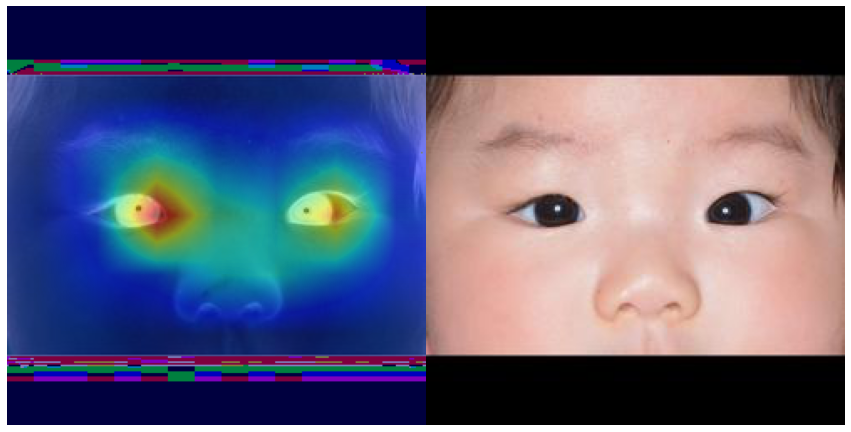



1247.jpg
label: exo
pred: exo

218.jpg
label: exo
pred: exo

2661.jpg
label: exo
pred: exo

1139.jpg
label: exo
pred: exo

1673.jpg
label: exo
pred: exo

8567.jpg
label: exo
pred: exo

1078.jpg
label: exo
pred: exo

256.jpg
label: exo
pred: exo

770.jpg
label: exo
pred: exo

1491.jpg
label: exo
pred: exo

999.jpg
label: exo
pred: exo

2579.jpg
label: exo
pred: exo

2289.jpg
label: exo
pred: exo

2679.jpg
label: exo
pred: exo

1274.jpg
label: exo
pred: exo

6279.jpg
label: exo
pred: exo

2118.jpg
label: exo
pred: exo

1713.jpg
label: exo
pred: exo

128.jpg
label: exo
pred: exo

2081.jpg
label: exo
pred: exo

2108.jpg
label: exo
pred: exo

1005.jpg
label: exo
pred: exo

2616.jpg
label: exo
pred: exo

1890.jpg
label: exo
pred: exo

3158.jpg
label: exo
pred: exo

215.jpg
label: exo
pred: exo

630.jpg
label: exo
pred: exo

339.jpg
label: exo
pred: exo

1896.jpg
label: exo
pred: exo

815.jpg
label: exo
pred: exo

268.jpg
label: exo
pred: cont


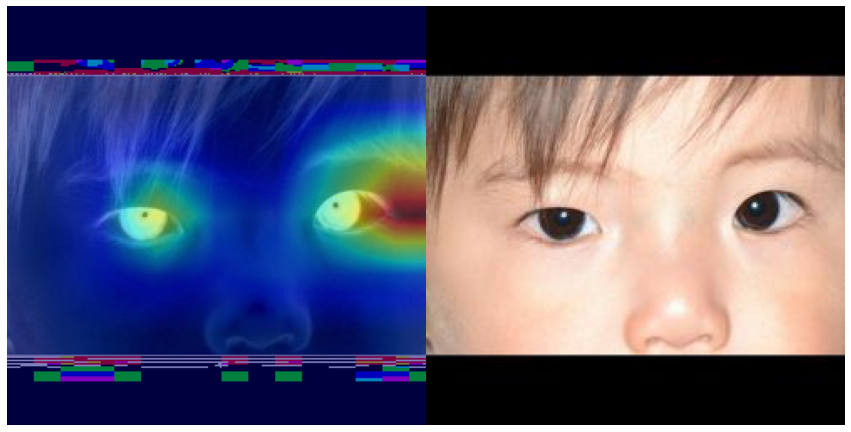



2580.jpg
label: exo
pred: exo

3366.jpg
label: exo
pred: exo

1724.jpg
label: exo
pred: exo

648.jpg
label: exo
pred: exo

4435.jpg
label: exo
pred: exo

2046.jpg
label: exo
pred: exo

1958.jpg
label: exo
pred: exo

2302.jpg
label: exo
pred: exo

2245.jpg
label: exo
pred: exo

1407.jpg
label: exo
pred: exo

1865.jpg
label: exo
pred: cont


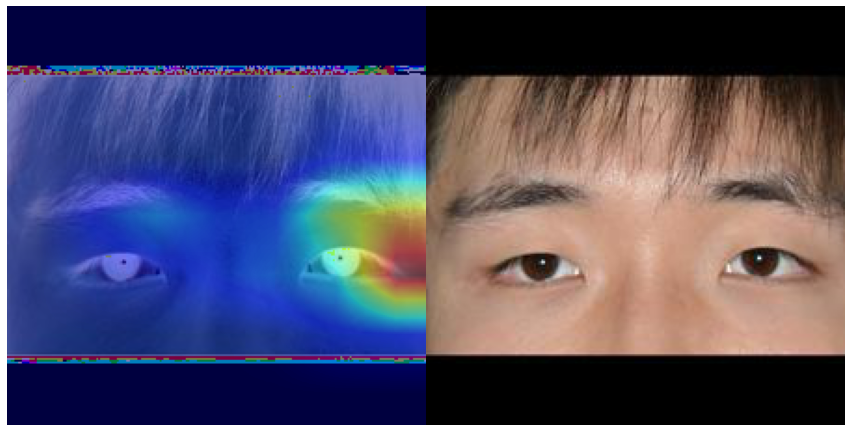



7712.jpg
label: exo
pred: cont


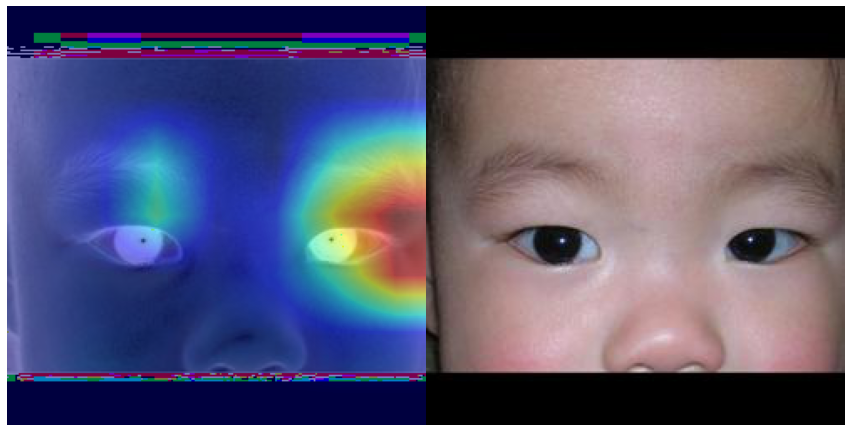



2700.jpg
label: exo
pred: exo

9758.jpg
label: exo
pred: cont


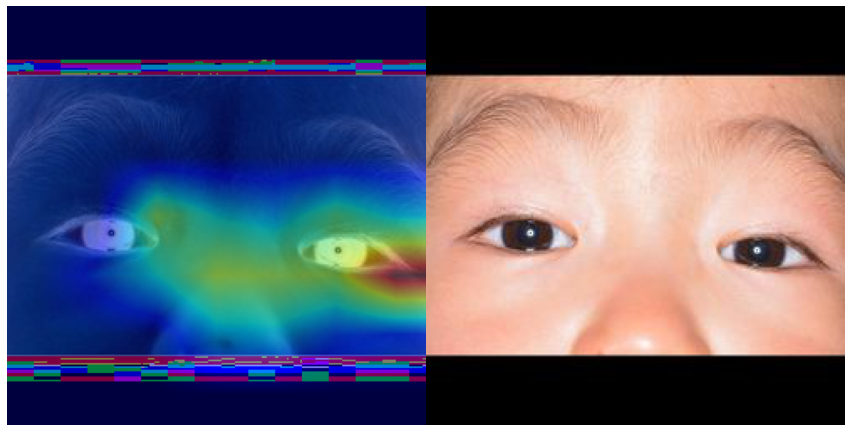



240.jpg
label: exo
pred: exo

1117.jpg
label: exo
pred: exo

1905.jpg
label: exo
pred: exo

525.jpg
label: exo
pred: exo

1662.jpg
label: exo
pred: exo

3210.jpg
label: exo
pred: exo

1961.jpg
label: exo
pred: exo

41.jpg
label: exo
pred: exo

3290.jpg
label: exo
pred: exo

1771.jpg
label: exo
pred: exo

2529.jpg
label: exo
pred: exo

7.jpg
label: exo
pred: exo

2675.jpg
label: exo
pred: exo

558.jpg
label: exo
pred: exo

8863.jpg
label: exo
pred: exo

1774.jpg
label: exo
pred: exo

2278.jpg
label: exo
pred: exo

3084.jpg
label: exo
pred: exo

1459.jpg
label: exo
pred: exo

1975.jpg
label: exo
pred: exo

1792.jpg
label: exo
pred: exo

2238.jpg
label: exo
pred: exo

1741.jpg
label: exo
pred: exo

2622.jpg
label: exo
pred: cont


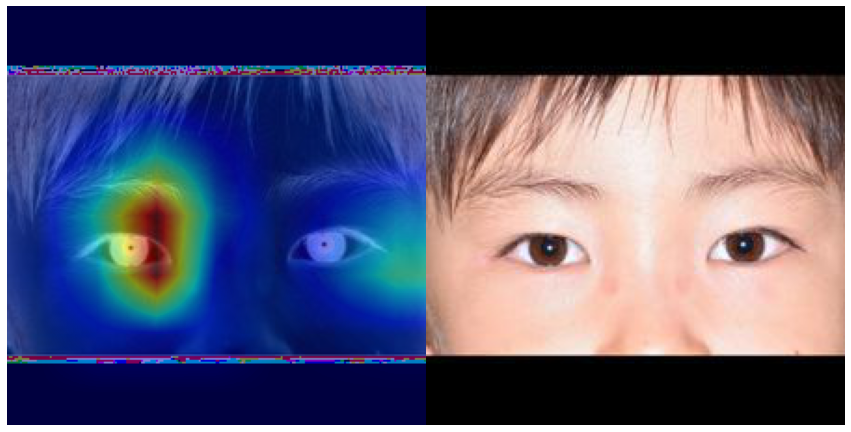



784.jpg
label: exo
pred: exo

2646.jpg
label: exo
pred: exo

2073.jpg
label: exo
pred: exo

2063.jpg
label: cont
pred: exo


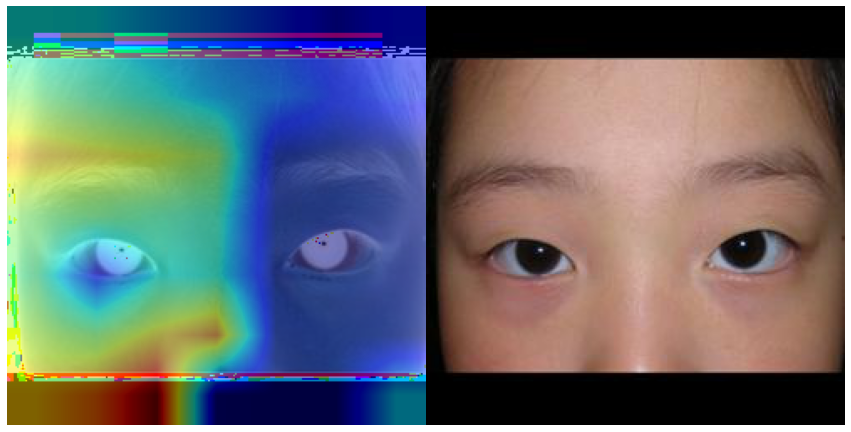



2695.jpg
label: cont
pred: cont

1424.JPG
label: cont
pred: cont

4417.jpg
label: cont
pred: exo


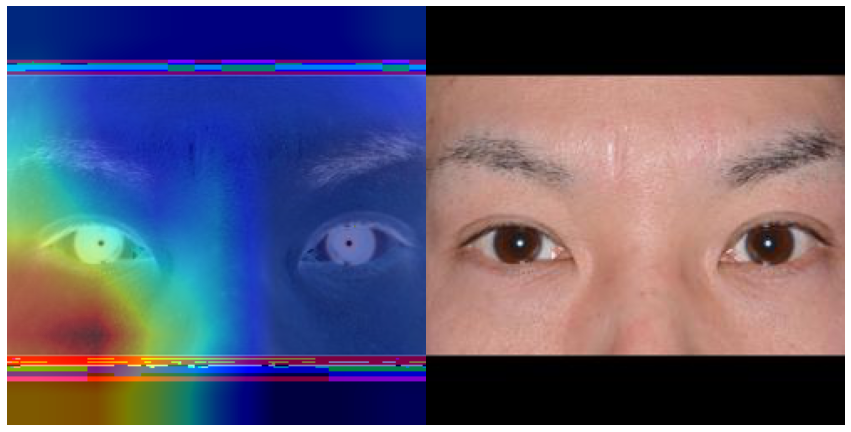



5946.jpg
label: cont
pred: cont

809.JPG
label: cont
pred: cont

4695.jpg
label: cont
pred: cont

1868.JPG
label: cont
pred: cont

7817.JPG
label: cont
pred: cont

4696.jpg
label: cont
pred: cont

6371.jpg
label: cont
pred: cont

4979.jpg
label: cont
pred: cont

3055.jpg
label: cont
pred: cont

2003.jpg
label: cont
pred: cont

2209.jpg
label: cont
pred: cont

5782.jpg
label: cont
pred: exo


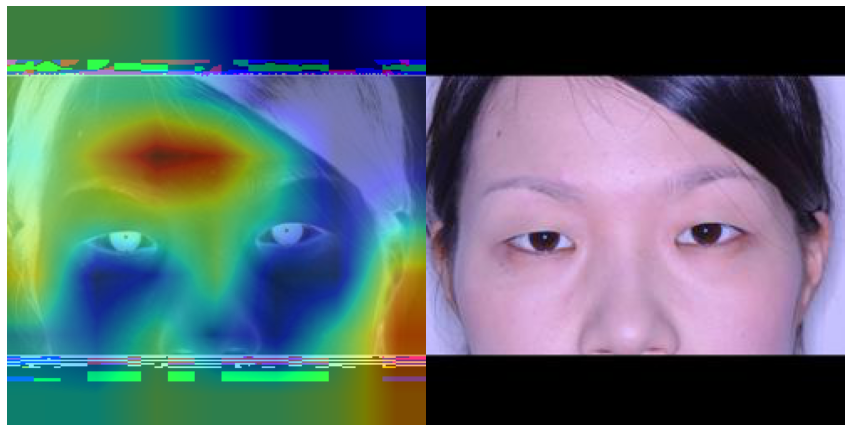



3153.jpg
label: cont
pred: cont

9805.jpg
label: cont
pred: cont

1844.jpg
label: cont
pred: cont

8040.jpg
label: cont
pred: cont

1938.jpg
label: cont
pred: cont

1050.jpg
label: cont
pred: cont

1638.jpg
label: cont
pred: cont

5697.jpg
label: cont
pred: cont

4336.JPG
label: cont
pred: cont

392.jpg
label: cont
pred: cont

4349.jpg
label: cont
pred: cont

1953.jpg
label: cont
pred: cont

5887.jpg
label: cont
pred: cont

1921.JPG
label: cont
pred: cont

4315.JPG
label: cont
pred: cont

1465.jpg
label: cont
pred: cont

2311.jpg
label: cont
pred: cont

8191.jpg
label: cont
pred: cont

4496.jpg
label: cont
pred: cont

1758.JPG
label: cont
pred: cont

9540.jpg
label: cont
pred: cont

2383.jpg
label: cont
pred: cont

1635.JPG
label: cont
pred: cont

4020.jpg
label: cont
pred: cont

1934.jpg
label: cont
pred: cont

7261.jpg
label: cont
pred: cont

5086.jpg
label: cont
pred: cont

5623.jpg
label: cont
pred: cont

4028.jpg
label: cont
pred: cont

821.jpg
label: cont
pred: cont

8192.JPG
l

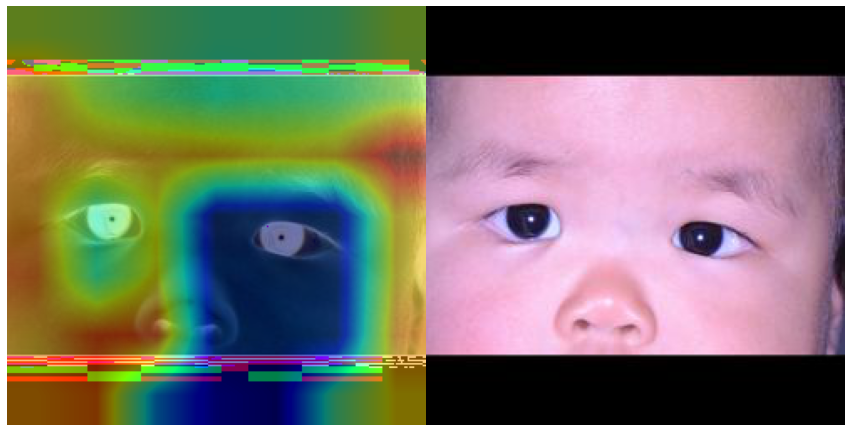



8216.jpg
label: cont
pred: exo


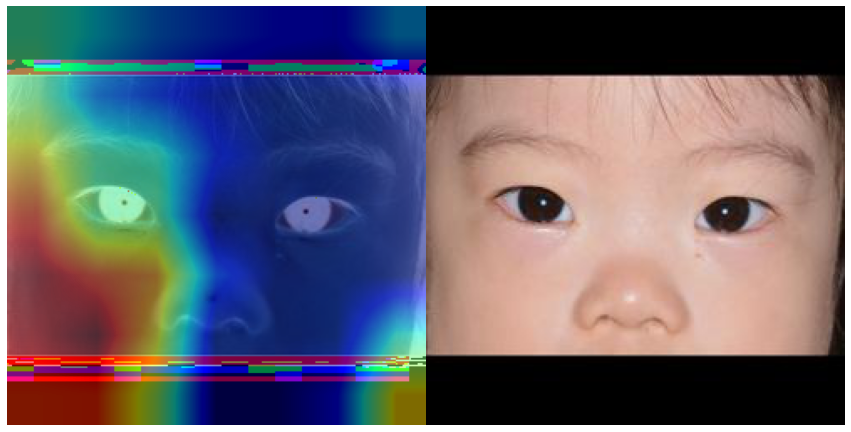



1912.jpg
label: cont
pred: cont

4848.jpg
label: cont
pred: cont

5767.jpg
label: cont
pred: cont

622.jpg
label: cont
pred: cont

9543.jpg
label: cont
pred: cont

6318.jpg
label: cont
pred: cont

1201.jpg
label: cont
pred: exo


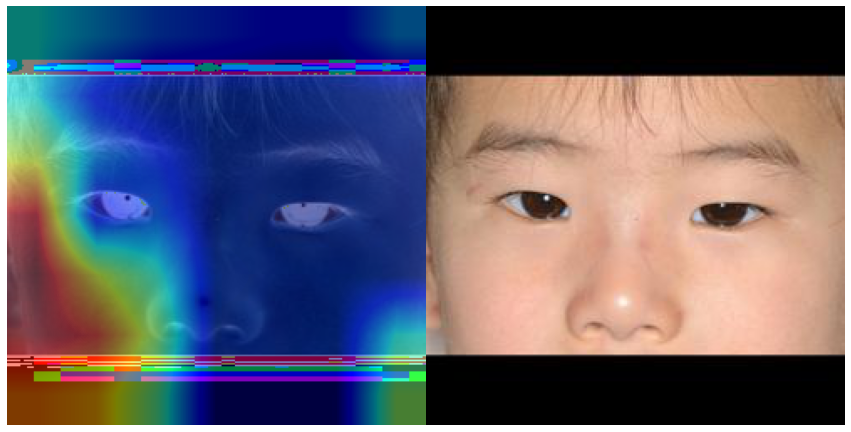



4270.jpg
label: cont
pred: cont

6768.jpg
label: cont
pred: cont

1946.jpg
label: cont
pred: cont

3284.jpg
label: cont
pred: cont

6354.jpg
label: cont
pred: cont

4742.jpg
label: cont
pred: exo


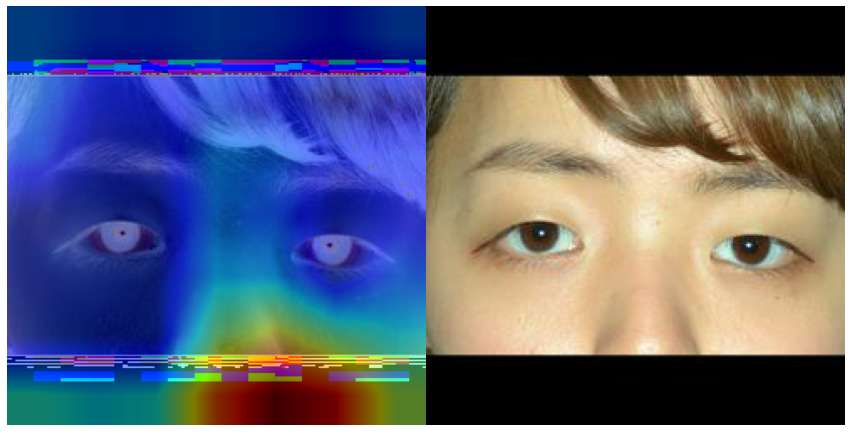



4818.jpg
label: cont
pred: cont

4173.jpg
label: cont
pred: exo


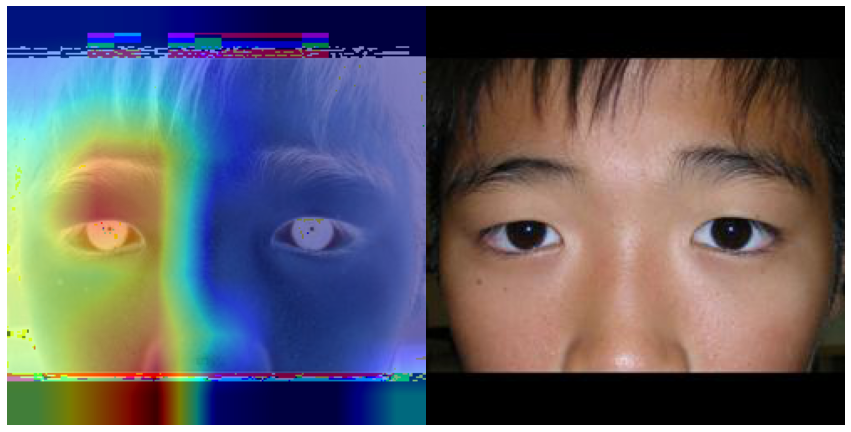



904.jpg
label: cont
pred: cont

2080.jpg
label: cont
pred: cont

9256.jpg
label: cont
pred: cont

1116.jpg
label: cont
pred: cont

4260.jpg
label: cont
pred: cont

172.jpg
label: cont
pred: cont

2827.jpg
label: cont
pred: exo


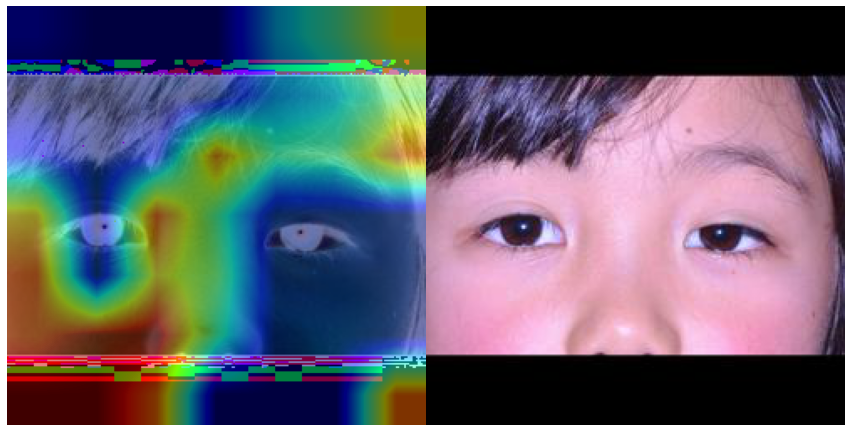



1865.jpg
label: cont
pred: cont

8739.jpg
label: cont
pred: exo


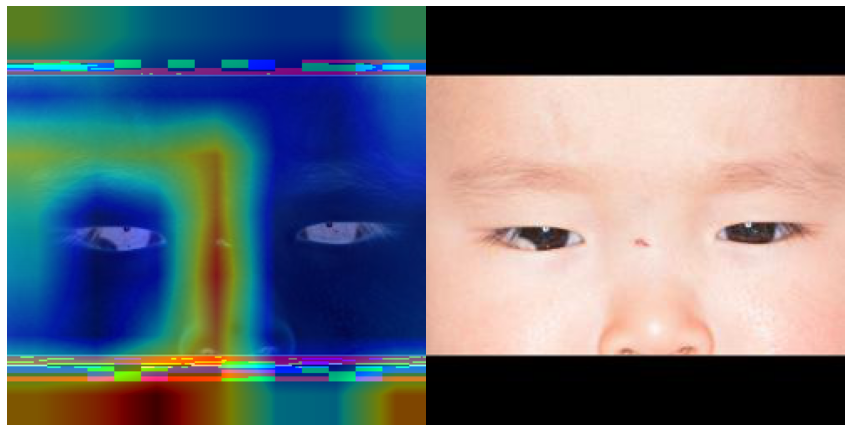



1708.jpg
label: cont
pred: cont

2449.jpg
label: cont
pred: exo


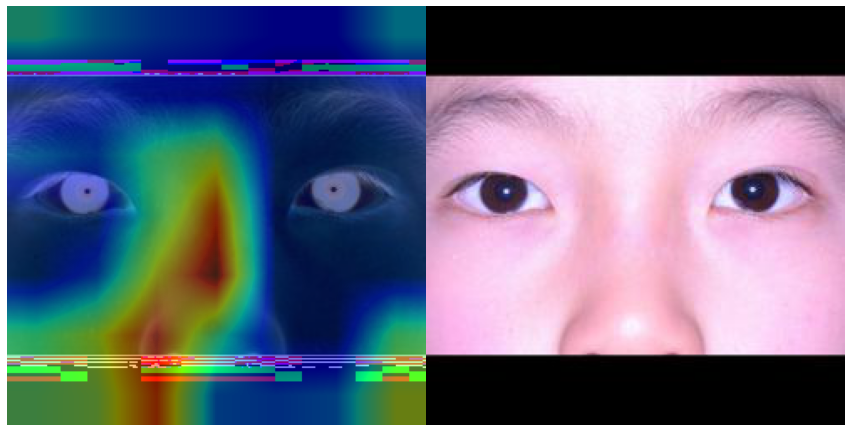



988.jpg
label: cont
pred: cont

8707.jpg
label: cont
pred: exo


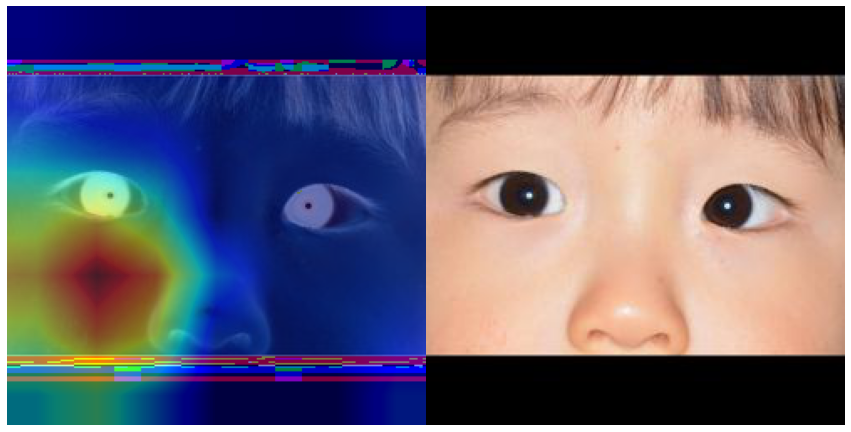



946.JPG
label: cont
pred: cont

7134.jpg
label: cont
pred: cont

8138.jpg
label: cont
pred: cont

8408.jpg
label: cont
pred: cont

1709.jpg
label: cont
pred: cont

4755.jpg
label: cont
pred: cont

9258.jpg
label: cont
pred: cont

3215.jpg
label: cont
pred: cont

8662.jpg
label: cont
pred: exo


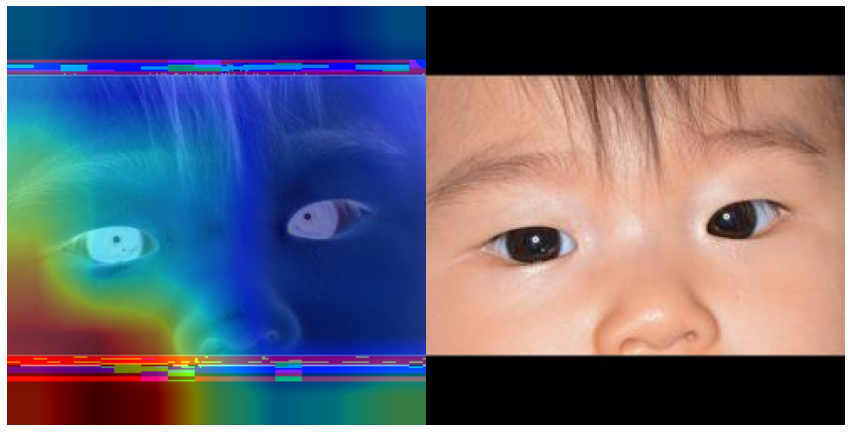



742.jpg
label: exo
pred: exo

1906.jpg
label: exo
pred: exo

1540.jpg
label: exo
pred: exo

1499.jpg
label: exo
pred: exo

4010.jpg
label: exo
pred: exo

4077.jpg
label: exo
pred: exo

1752.jpg
label: exo
pred: exo

835.jpg
label: exo
pred: exo

690.jpg
label: exo
pred: exo

599.jpg
label: exo
pred: exo

6445.jpg
label: exo
pred: exo

463.jpg
label: exo
pred: exo

694.jpg
label: exo
pred: exo

1220.jpg
label: exo
pred: exo

9339.jpg
label: exo
pred: exo

4496.jpg
label: exo
pred: exo

267.jpg
label: exo
pred: exo

3636.jpg
label: exo
pred: exo

1547.jpg
label: exo
pred: exo

318.jpg
label: exo
pred: exo

2572.jpg
label: exo
pred: exo

2584.jpg
label: exo
pred: exo

1474.jpg
label: exo
pred: cont


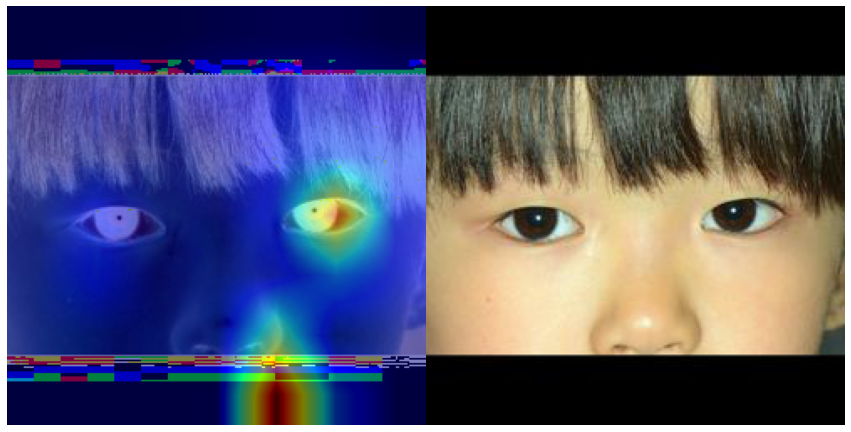



9236.jpg
label: exo
pred: cont


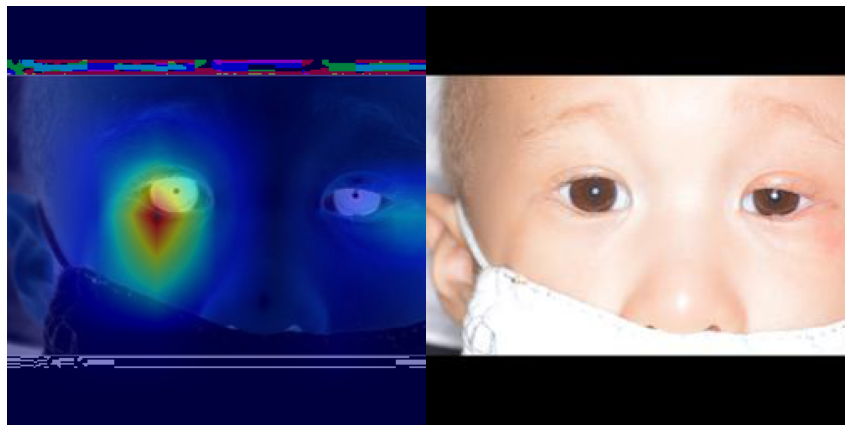



825.jpg
label: exo
pred: exo

441.jpg
label: exo
pred: exo

190.jpg
label: exo
pred: exo

1210.jpg
label: exo
pred: exo

715.jpg
label: exo
pred: exo

1337.jpg
label: exo
pred: exo

1787.jpg
label: exo
pred: exo

3726.jpg
label: exo
pred: exo

9.jpg
label: exo
pred: exo

1334.jpg
label: exo
pred: cont


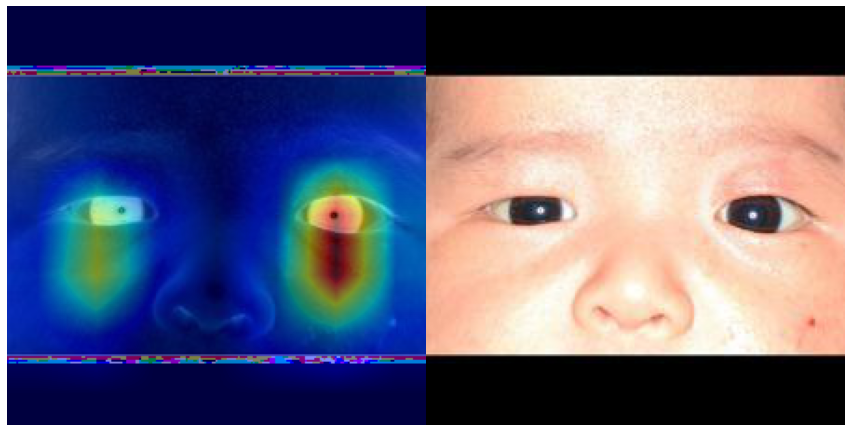



1623.jpg
label: exo
pred: exo

8336.jpg
label: exo
pred: exo

2178.jpg
label: exo
pred: exo

8207.jpg
label: exo
pred: exo

800.jpg
label: exo
pred: exo

4229.jpg
label: exo
pred: exo

796.jpg
label: exo
pred: exo

3796.jpg
label: exo
pred: exo

2287.jpg
label: exo
pred: exo

3218.jpg
label: exo
pred: exo

1863.jpg
label: exo
pred: exo

1539.jpg
label: exo
pred: exo

29.jpg
label: exo
pred: exo

2575.jpg
label: exo
pred: exo

845.jpg
label: exo
pred: exo

791.jpg
label: exo
pred: exo

349.jpg
label: exo
pred: exo

1400.jpg
label: exo
pred: exo

1027.jpg
label: exo
pred: exo

2045.jpg
label: exo
pred: exo

395.jpg
label: exo
pred: exo

751.jpg
label: exo
pred: exo

3530.jpg
label: exo
pred: exo

1964.jpg
label: exo
pred: exo

1115.jpg
label: exo
pred: exo

1707.jpg
label: exo
pred: exo

2181.jpg
label: exo
pred: exo

2598.jpg
label: exo
pred: exo

409.jpg
label: exo
pred: exo

408.jpg
label: exo
pred: exo

2285.jpg
label: exo
pred: exo

1329.jpg
label: exo
pred: exo

382.jpg
label: ex

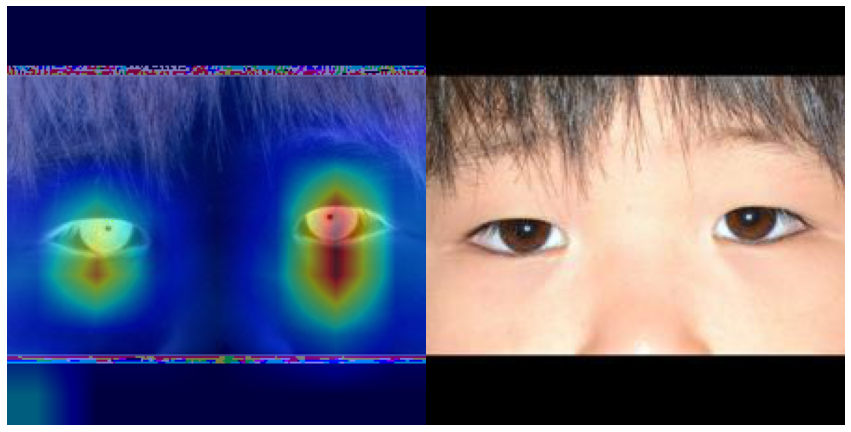



Image_presented: 76


In [70]:
#一気に解析 GradCAM

#GradCAM
test_path = "/content/drive/MyDrive/Deep_learning/Strabismus/Dataset_250px_shuffle3_crossvalidation_exo"
test_folder = [0,1,2,3,4] #クロスバリデーションのフォルダ


k=0
for folder in test_folder:
    image_dataset = glob.glob(test_path + "/"  +str(folder)+"/val/*/*") 
    model_path = test_path + "/ResNet50_pretrained_all_" +str(folder) +".pth"
    classes = os.listdir(test_path + "/"  +str(folder)+ "/val")

    #ネットワークの作成
    model_ft = models.resnet50(pretrained=False)
    num_ftrs = model_ft.fc.in_features
    model_ft.fc = nn.Linear(num_ftrs, 2)

    #GPU使用
    model_ft = model_ft.to(device)

    #ネットワークの読み込み
    model_ft.load_state_dict(torch.load(model_path))

    # Split model in two parts
    features_fn = nn.Sequential(*list(model_ft.children())[:-2]) #最後の2層（AdaptiveAvgPool2dとLinear)を取り除いたもの
    classifier_fn = nn.Sequential(*(list(model_ft.children())[-2:-1] + [Flatten()] + list(model_ft.children())[-1:])) #最終層の前にFlatten()を挿入
    #最後の2層

    #評価モードにする    
    model_ft = model_ft.eval()
    model_ft = model_ft.to(device)


    #random.shuffle(image_dataset)
    #画像のパスを指定
    for j in image_dataset: #image_dataset[0:1]とすると１枚だけ表示できる

        #元画像
        img_name, label = getlabel(j)
        img_tensor = image_transform(j)
        image= np.asarray(Image.open(j))

        #Softmaxにかけたときの確率上位1つのpp(確率)とcc(class番号)を取得(tench→正常,goldfish→斜視)
        pp, cc = torch.topk(nn.Softmax(dim=1)(model_ft(img_tensor.to(device))), 1)

        #pとcを対にして入力
        for i, (p, c) in enumerate(zip(pp[0], cc[0])):  
            sal = GradCAM(img_tensor, int(c), features_fn, classifier_fn)
            tmp = image
            img = Image.fromarray((tmp*255).astype(np.uint8))
            #TensorをImageに変換
            sal = Image.fromarray(sal)
            sal = sal.resize(img.size, resample=Image.LINEAR)

            print(img_name)
            print("label: " +label)
            temp_label = c.item()
            pred = classes[temp_label]
            print("pred: "+ pred)

            #print(img_path) #あとで参照しやすいように画像のパスを表示

            #plt.title('')
            #print('label: '+labels[image_datasets['val'][j][1]])
            #print('pred:  '+'{}  {:.1f}%'.format(labels[c], 100*float(p)))
            #plt.title('pred:'+'{}: { .1f}%'.format(labels[c], 100*float(p)))        
            if label != pred:
                plt.figure(figsize=(15, 10))

                #グラフを1行2列に並べたうちの1番目
                plt.subplots_adjust(wspace=0,hspace=0)
                plt.subplot(1, 2, 1)
                plt.axis('off')
                plt.imshow(img)
                plt.imshow(np.array(sal), alpha=0.5, cmap='jet')

                #元の画像を並べて表示
                plt.subplot(1, 2, 2)
                plt.axis('off')
                plt.imshow(image)

                plt.show()
                print("")
                k+=1
            print("")
print("Image_presented: "+str(k)) #表示させた枚数を記載